#**MUSIC GENRE PREDICTION**

#**ABSTRACT**

### **MUSIC GENRE PREDICTION**


The dataset aims to facilitate the prediction of music genres based on various audio features extracted from music tracks from Spotify. This dataset offers a comprehensive collection of features including tempo, energy, loudness, acousticness, danceability, and others. The notebook used methods such as histogram plotting, box plots of Python's Matplotlib and Seaborn library to answer questions about the dataset, including data types, missing values, likely distributions of numeric variables, and the usefulness of independent variables in predicting the target variable.

Additionally, H2O.ai AutoML was employed to create predictive models and interpret their results. The relationship significance, violation of model assumptions, multicollinearity, and significance of independent variables were assessed. SHAP (SHapley Additive exPlanations) analysis was conducted to explore model interpretability and compare different models' results. This included fitting linear models, tree-based models, and utilizing AutoML to find the best model, followed by SHAP analysis on these models to interpret feature importance.

This project addresses a multi-class classification problem, with the target genres including but not limited to: pop, rock, jazz, hip-hop, electronic, classical, and country.

This study also aims to provide a comprehensive understanding of model interpretability in music genre prediction, utilizing SHAP analysis as a powerful tool for elucidating feature importance and enhancing the transparency of predictive models.

## **DATASET**

The dataset consists of a set of audio features provided by spotify
It consists of 18 columns

instance_id       
artist_name        
track_name        
popularity        
acousticness      
danceability      
duration_ms       
energy            
instrumentalness  
key               
liveness          
loudness          
mode              
speechiness       
tempo             
obtained_date     
valence           
music_genre  

The target variable is music_genre

The full list of genres included are : 'Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Rap', 'Blues', 'Rock', 'Classical', 'Hip-Hop'

There are a total of 50000 observations.

**OVERVIEW AND FLOW**

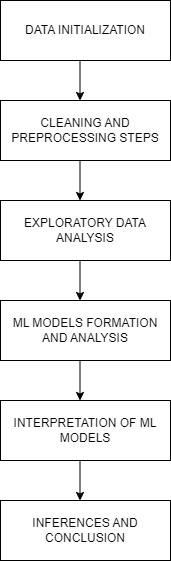

In [117]:
from IPython.display import Image

# Provide the file path to your image
image_path = "MLPROJECT.png"

# Display the image
Image(filename=image_path)

## **IMPORTING NECESSARY LIBRARIES**

In [84]:
# installing dependencies
!pip install eli5

In [85]:
pip install shap

In [86]:
#Importing all packages
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import pyplot
from sklearn.preprocessing import LabelEncoder

## **READING THE DATASET**

In [87]:
# Reading the music genre dataset
data = pd.read_csv(
    "https://raw.githubusercontent.com/Malini240/DataScience_Music_Genre_Prediction_Dataset/main/music_genre.csv"
)
data.head()

,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
0,32894.0,Röyksopp,Röyksopp's Night Out,27.0,0.00468,0.652,-1.0,0.941,0.79200,A#,0.115,-5.201,Minor,0.0748,100.889,04-Apr,0.759,Electronic
1,46652.0,Thievery Corporation,The Shining Path,31.0,0.01270,0.622,218293.0,0.890,0.95000,D,0.124,-7.043,Minor,0.0300,115.002,04-Apr,0.531,Electronic
2,30097.0,Dillon Francis,Hurricane,28.0,0.00306,0.620,215613.0,0.755,0.01180,G#,0.534,-4.617,Major,0.0345,127.994,04-Apr,0.333,Electronic
3,62177.0,Dubloadz,Nitro,34.0,0.02540,0.774,166875.0,0.700,0.00253,C#,0.157,-4.498,Major,0.2390,128.014,04-Apr,0.270,Electronic
4,24907.0,What So Not,Divide & Conquer,32.0,0.00465,0.638,222369.0,0.587,0.90900,F#,0.157,-6.266,Major,0.0413,145.036,04-Apr,0.323,Electronic


## **SUMMARY OF DATAFRAME STRUCTURE**

In [88]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50005 entries, 0 to 50004
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   instance_id       50000 non-null  float64
 1   artist_name       50000 non-null  object 
 2   track_name        50000 non-null  object 
 3   popularity        50000 non-null  float64
 4   acousticness      50000 non-null  float64
 5   danceability      50000 non-null  float64
 6   duration_ms       50000 non-null  float64
 7   energy            50000 non-null  float64
 8   instrumentalness  50000 non-null  float64
 9   key               50000 non-null  object 
 10  liveness          50000 non-null  float64
 11  loudness          50000 non-null  float64
 12  mode              50000 non-null  object 
 13  speechiness       50000 non-null  float64
 14  tempo             45020 non-null  float64
 15  obtained_date     50000 non-null  object 
 16  valence           50000 non-null  float6

---

***Q. What are the data types? (Only numeric and categorical)***

In [89]:
# Inspecting data types of columns
data_types = data.dtypes


# Count categorical and numerical columns
numerical_count = data.select_dtypes(include=['int64', 'float64']).shape[1]
categorical_count = data.select_dtypes(include=['object']).shape[1]

# Filter numerical and categorical columns
numerical_columns = data.select_dtypes(include=['int64', 'float64'])
categorical_columns = data.select_dtypes(include=['object'])

print("Original data Types of Columns:")
print(data_types)

print("\nTotal Numerical Columns:", numerical_count)
print("Total Categorical Columns:", categorical_count)

# Inspecting data types of columns
data_types = data.dtypes


# Count categorical and numerical columns
numerical_count = data.select_dtypes(include=['int64', 'float64']).shape[1]
categorical_count = data.select_dtypes(include=['object']).shape[1]

# Filter numerical and categorical columns
numerical_columns = data.select_dtypes(include=['int64', 'float64'])
categorical_columns = data.select_dtypes(include=['object'])


print("\nNumerical Columns:")
print(numerical_columns.columns.tolist())

print("\nOriginal Categorical Columns:")
print(categorical_columns.columns.tolist())
print("Original Categorical Column Count:", categorical_count)

# Actual categorical columns
categorical_columns_actual = data[['key', 'mode', 'music_genre']]

print("\nActual Categorical Columns:")
print(categorical_columns_actual.columns.tolist())
print("Actual Categorical Column Count:", categorical_columns_actual.shape[1])

Original data Types of Columns:
instance_id         float64
artist_name          object
track_name           object
popularity          float64
acousticness        float64
danceability        float64
duration_ms         float64
energy              float64
instrumentalness    float64
key                  object
liveness            float64
loudness            float64
mode                 object
speechiness         float64
tempo               float64
obtained_date        object
valence             float64
music_genre          object
dtype: object

Total Numerical Columns: 12
Total Categorical Columns: 6

Numerical Columns:
['instance_id', 'popularity', 'acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence']

Original Categorical Columns:
['artist_name', 'track_name', 'key', 'mode', 'obtained_date', 'music_genre']
Original Categorical Column Count: 6

Actual Categorical Columns:
['key', 'mode', 'music_genre']
A

## **SUMMARY OF STATISTICAL INFORMATION**

In [90]:
data.describe()

,instance_id,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
count,50000.000000,50000.000000,50000.000000,50000.000000,5.000000e+04,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,45020.000000,50000.000000
mean,55888.396360,44.220420,0.306383,0.558241,2.212526e+05,0.599755,0.181601,0.193896,-9.133761,0.093586,119.952961,0.456264
std,20725.256253,15.542008,0.341340,0.178632,1.286720e+05,0.264559,0.325409,0.161637,6.162990,0.101373,30.641701,0.247119
min,20002.000000,0.000000,0.000000,0.059600,-1.000000e+00,0.000792,0.000000,0.009670,-47.046000,0.022300,34.347000,0.000000
25%,37973.500000,34.000000,0.020000,0.442000,1.748000e+05,0.433000,0.000000,0.096900,-10.860000,0.036100,94.941500,0.257000
50%,55913.500000,45.000000,0.144000,0.568000,2.192810e+05,0.643000,0.000158,0.126000,-7.276500,0.048900,119.879000,0.448000
75%,73863.250000,56.000000,0.552000,0.687000,2.686122e+05,0.815000,0.155000,0.244000,-5.173000,0.098525,140.471250,0.648000
max,91759.000000,99.000000,0.996000,0.986000,4.830606e+06,0.999000,0.996000,1.000000,3.744000,0.942000,220.276000,0.992000


## **DATA CLEANING**

***Q. Are there missing values?***

In [91]:
# Check for missing values
missing_values = data.isna().sum()
print("Columns with missing values:")
print(missing_values);

Columns with missing values:
instance_id            5
artist_name            5
track_name             5
popularity             5
acousticness           5
danceability           5
duration_ms            5
energy                 5
instrumentalness       5
key                    5
liveness               5
loudness               5
mode                   5
speechiness            5
tempo               4985
obtained_date          5
valence                5
music_genre            5
dtype: int64


## **HANDLING MISSING VALUES**

In [92]:
#Display empty rows
print("Empty rows count :",data.isnull().all(axis=1).sum())


# Check for duplicate rows
duplicate_rows = data[data.duplicated()]


# Get the number of duplicate rows
num_duplicate_rows = len(duplicate_rows)
print("Number of duplicate rows:", num_duplicate_rows)

# Get the number of rows where duration is -1
print("Row count with duration -1 :",data[data['duration_ms'] == -1.0].shape[0])

Empty rows count : 5
Number of duplicate rows: 4
Row count with duration -1 : 4939


In [93]:
#Dropping rows with no data
data.dropna(how="all",inplace=True)
data.isna().sum()

#Dropping rows where duration is -1
data.drop(data.loc[data['duration_ms'] == -1.0].index, inplace=True)

print("Empty rows count :",data.isnull().all(axis=1).sum())
print("Row count with duration -1 :",data[data['duration_ms'] == -1.0].shape[0])



Empty rows count : 0
Row count with duration -1 : 0


**Handling missing values for tempo**

KNN imputation considers the feature space and identifies the nearest neighbors for each missing value based on other available features. This allows it to better preserve the relationships between variables compared to imputation methods like median or mean imputation.

Number of missing values in 'tempo' column: 4501


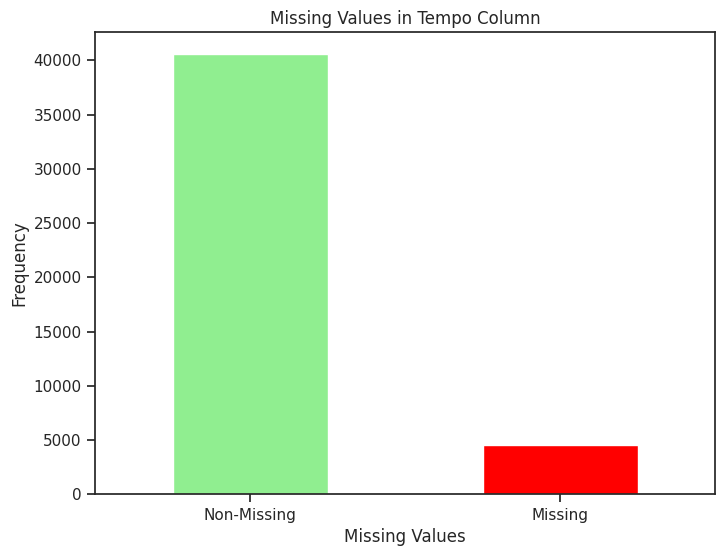

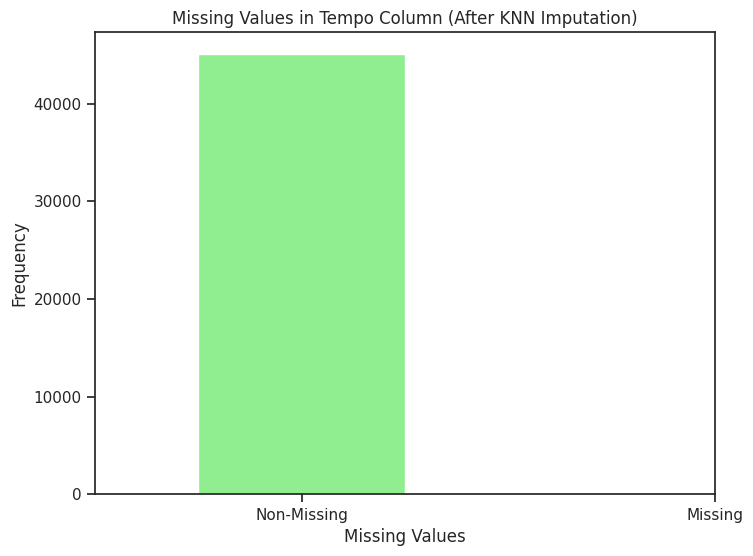

In [94]:
import matplotlib.pyplot as plt
from sklearn.impute import KNNImputer

# Check for missing values in the 'tempo' column
missing_tempo = data['tempo'].isnull().sum()
print("Number of missing values in 'tempo' column:", missing_tempo)

# Create a bar plot to visualize missing values
plt.figure(figsize=(8, 6))
data['tempo'].isnull().value_counts().plot(kind='bar', color=['lightgreen', 'red'])
plt.title('Missing Values in Tempo Column')
plt.xlabel('Missing Values')
plt.ylabel('Frequency')
plt.xticks([0, 1], ['Non-Missing', 'Missing'], rotation=0)
plt.show()

# Instantiate KNNImputer
imputer = KNNImputer(n_neighbors=5)

# Impute missing values with KNN imputation
data['tempo'] = imputer.fit_transform(data[['tempo']])

# Create a bar plot to visualize missing values after imputation
plt.figure(figsize=(8, 6))
data['tempo'].isnull().value_counts().plot(kind='bar', color=['lightgreen', 'red'])
plt.title('Missing Values in Tempo Column (After KNN Imputation)')
plt.xlabel('Missing Values')
plt.ylabel('Frequency')
plt.xticks([0, 1], ['Non-Missing', 'Missing'], rotation=0)
plt.show()


In [95]:
# Checking that missing values have been imputed
missing_tempo_after_imputation = data['tempo'].isnull().sum()
print("Number of missing values in 'tempo' column after imputation:", missing_tempo_after_imputation)

Number of missing values in 'tempo' column after imputation: 0


## **Checking high entropy features**

In [96]:
#Checking high entropy features

#The features that are diverse throughout the dataset tend to have very less predictive properties and thus cannot be used for modeling

#instance_id unique values
print("Unique value count of instance_id:",len(data["instance_id"].unique()))

#track_name unique values
print("Unique value count of track_name:",len(data["track_name"].unique()))

#artist_name unique values
print("Unique value count of artist_name:",len(data["artist_name"].unique()))

#key unique values
print("Unique values for key :",data["key"].unique());

#mode unique values
print("Unique values for mode :",data["mode"].unique());

#date unique values
print("Unique values for date :",data["obtained_date"].unique());

#Target variable music genre  unique values
print("Unique values for  target  :",data["music_genre"].unique());







Unique value count of instance_id: 45061
Unique value count of track_name: 38086
Unique value count of artist_name: 6625
Unique values for key : ['D' 'G#' 'C#' 'F#' 'B' 'G' 'F' 'A' 'C' 'E' 'A#' 'D#']
Unique values for mode : ['Minor' 'Major']
Unique values for date : ['04-Apr' '03-Apr' '05-Apr' '01-Apr' '0/4']
Unique values for  target  : ['Electronic' 'Anime' 'Jazz' 'Alternative' 'Country' 'Rap' 'Blues' 'Rock'
 'Classical' 'Hip-Hop']


**Removing high entropy features**

 Key and mode are required for predicting the  target variable music genre

Artist_name can be removed since it does not directly contribute to prediction

instance_id is entirely unique for all rows , cannot be used for prediction and can be removed

Track_name is also non predictor variable for finding the music genre

obtained_date does not give much information and has only 4 dates of April without any year , so can be removed

In [97]:
#Removing all non predictor features
# data = data.drop(["artist_name","instance_id", "track_name", "obtained_date"], axis = 1)

data = data.drop(["instance_id", "track_name", "obtained_date"], axis = 1)
data.shape

(45061, 15)

## **EXPLORATORY DATA ANALYSIS**


Exploratory Data Analysis (EDA) is an approach to analyzing data sets to summarize their main characteristics, often employing data visualization techniques. The primary goal of EDA is to understand the data's structure, patterns, and relationships between variables in order to generate hypotheses, identify anomalies, and gain insights that may inform subsequent statistical analyses or machine learning modeling.

## **DATA VISUALIZATION FOR MAIN CATEGORICAL FEATURES**

### **DATA DISTRIBUTION FOR TARGET VARIABLE MUSIC GENRE**


In [98]:
def plot_counts(feature, order=None):
    sns.countplot(x=feature, data=data, hue=feature, palette="ocean", order=order, legend=False)
    plt.title(f"Counts in each {feature}")
    plt.show()

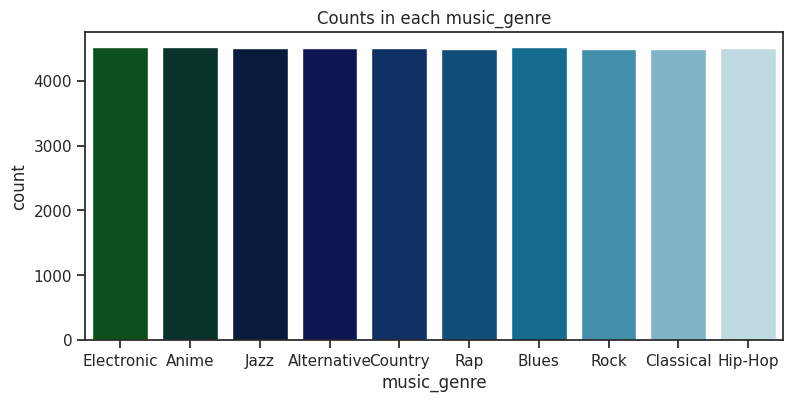

In [99]:
plt.figure(figsize = (9, 4))
plot_counts("music_genre")

In [100]:
data['music_genre'].value_counts()

Anime          4527
Electronic     4517
Blues          4517
Hip-Hop        4510
Alternative    4509
Country        4508
Jazz           4503
Rock           4493
Classical      4489
Rap            4488
Name: music_genre, dtype: int64


There are 10 different genres with equal distribution which is balanced data, hence resampling is not required

In [101]:
# Save the copy of DataFrame till this point
datawith_outliers=data.copy()

### **DATA VISUALIZATION FOR KEY AND MODE**

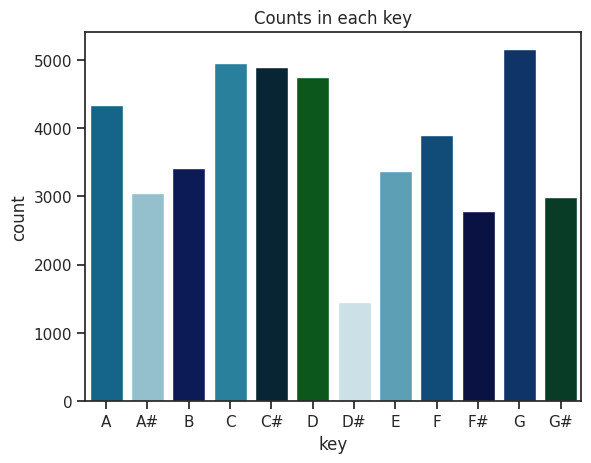

In [102]:
#Plot for keys
plot_counts("key", ["A", "A#", "B", "C", "C#", "D", "D#", "E", "F", "F#", "G", "G#"])

*As it can be observed from the above histogram plot, the most frequent key is G followed by C*

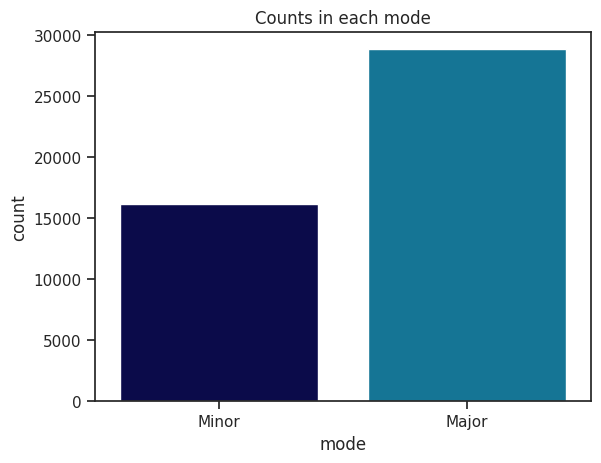

In [103]:
plot_counts("mode")

*As it can be observed from the above histogram plot, most songs are in major end of the spectrum*

**Q Distribution of numeric variables**


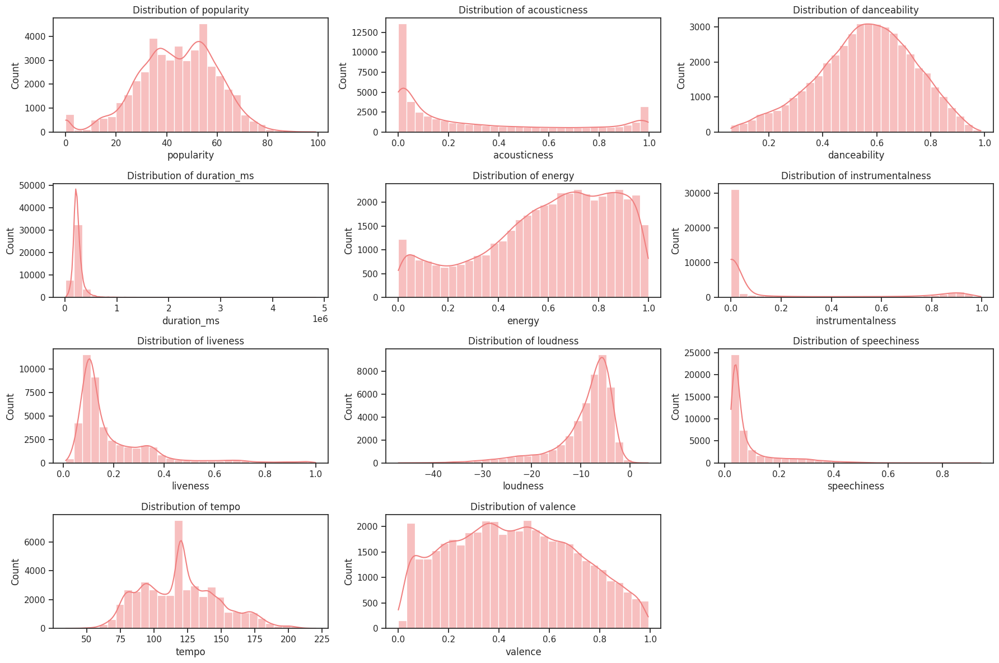

In [104]:
import matplotlib.pyplot as plt

# Storing numeric features in a separate variable for distribution
numeric_features = numerical_columns.drop(["instance_id"], axis=1)


# Setting the style of seaborn
sns.set(style="ticks")

# Creating subplots for each numerical feature
plt.figure(figsize=(18, 12))
for i, feature in enumerate(numeric_features, 1):
    plt.subplot(4, 3, i)
    sns.histplot(data[feature], kde=True, color='lightcoral', bins=30)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()

Popularity has bi-modal distribution having 2 peaks. Some values have much higher frequencies.

Acousticness is measured on a scale of 0.0 (not acoustic) to 1.0 (very acoustic). Songs with higher acousticness are more likely to use acoustic and non-electronic instruments. The subplot shows that most songs / music pieces are not acoustic.

Danceability quantifies how suitable a track is for dancing based on a combination of musical elements.. Songs with higher danceability have stronger and more regular beats. Like acousticness, danceability is measured on a scale of 0.0 (low danceability) to 1.0 (high danceability). In terms of danceability, values in this feature have an almost normal distribution.

Music duration is given in milliseconds. Most samples are not longer than 0.3e6 (300 000) milliseconds, or 300 seconds, or exactly 5 minutes which is reasonable.

Energy measures the perceived intensity and activity of a song. Energy is also measured on a scale of 0.0 (low energy) to 1.0 (high energy). Songs with higher energy are more intense, dynamic, and loud. The distribution on the subplot shows that most of the music pieces are described with high energy.

Instrumentalness predicts whether a track contains vocals. Instrumentalness is measured on a scale of 0.0 (likely contains vocal content) to 1.0 (likely contains no vocal content). Songs with higher instrumentalness are less likely to have vocals. Distribution of values in terms of instrumentalness is quite skewed - most samples has value of 0 or around 0, which means the songs are characterized with vocal content.

Liveness detects the presence of an audience in a song. Liveness is also measured on a scale of 0.0 (no audience) to 1.0 (audible audience). Songs with higher liveness are more likely to have been performed live. It seems the songs in our dataset are performed without audience - most liveness values are closer to 0.0 than to 1.0.

The next feature is loudness - it measures the decibel level of a song. Decibels are relative to a reference value, so songs with lower loudness values are quieter relative to the reference value of 0. Taking this into account, value distribution in loudness shows that most music samples are quieter (their loudness is closer to 0).

Speechiness measures the presence of spoken words in a song. It is measured on a scale of 0.0 (low speechiness) to 1.0 (high speechiness). Songs with higher speechiness are mostly composed of spoken words, like poetry . Distribution of speechiness is rather skewed on the right - most songs / pieces seem to have no or very small number of spoken words.

Tempo measures the beats per minute (bpm) of a song. Many popular songs range from 50 bpm to 200 bpm. Songs with higher tempo have a faster pace. Distribution of tempo values is very similar to that of "popularity".

And finally, valence measures the positivity of a song. It is measured on a scale from 0.0 (low valence) to 1.0 (high valence). Songs with higher valence sound happier and more cheerful. Distribution of valence in dataset is not very normal - valence of most songs is somewhere between 0.2 and 0.7. Only a tiny number of songs are characterised with high valence.

 **Q Do the ranges of the predictor variables make sense?**

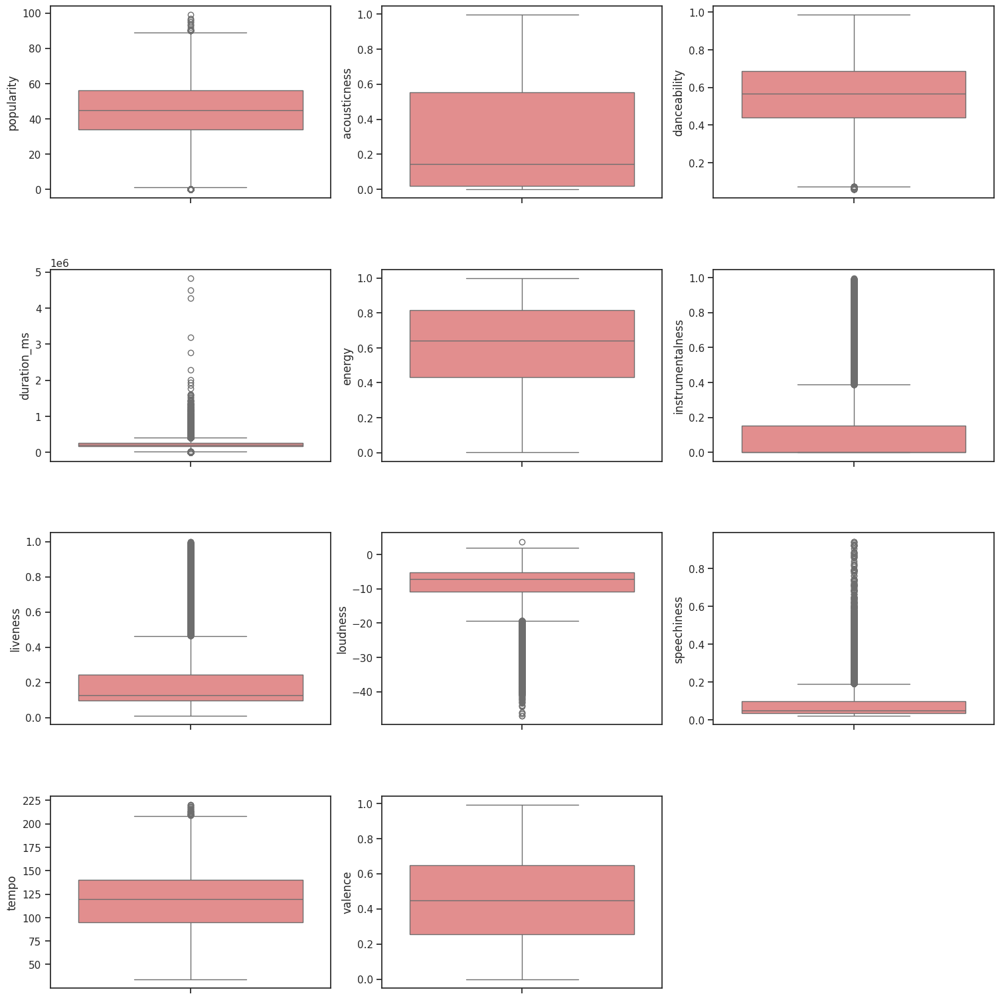

In [105]:
## Checking the Ranges of the predictor variables and dependent variable
fig, axs = plt.subplots(ncols = 3, nrows = 4, figsize = (15, 15))
fig.delaxes(axs[3][2])
idx = 0
axs = axs.flatten()
for k, v in numeric_features.items():
    sns.boxplot(y = k, data = numeric_features, ax = axs[idx],color="lightcoral")
    idx += 1
plt.tight_layout(pad = 0.4, w_pad = 0.5, h_pad = 5.0)

The range makes sense but some of the features such as loudness, liveness,speechiness, duration and instrumentalness have outliers that needs to be normalized

## **Handling outliers**


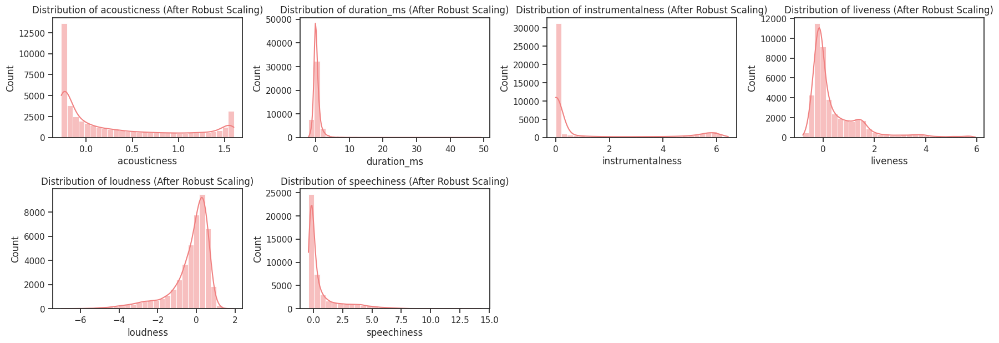

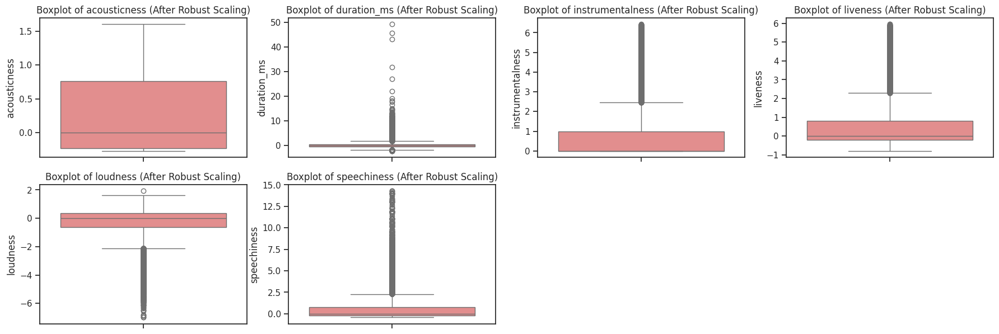

In [106]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import RobustScaler

# Initialize RobustScaler
scaler = RobustScaler()

# Convert ms to s since duration has a lot of outliers
data["duration_ms"] = data["duration_ms"] / 1000

# Features to be transformed
skewed_features = numeric_features.drop(["tempo", "popularity", "danceability", "valence", "energy"], axis=1)

# Apply RobustScaler to skewed features and reset index
scaled_features = scaler.fit_transform(skewed_features)
scaled_df = pd.DataFrame(scaled_features, columns=skewed_features.columns, index=skewed_features.index)

# Assign scaled features back to the original DataFrame
data[skewed_features.columns] = scaled_df

# Plot the transformed distributions and boxplots
plt.figure(figsize=(18, 12))

# Plot the transformed distributions for the original skewed features
for i, feature in enumerate(skewed_features, 1):
    plt.subplot(4, 4, i)
    sns.histplot(data[feature], kde=True, color='lightcoral', bins=30)
    plt.title(f'Distribution of {feature} (After Robust Scaling)')

plt.tight_layout()

# Create boxplots for the transformed features
plt.figure(figsize=(18, 12))

# Boxplots for the original skewed features
for i, feature in enumerate(skewed_features, 1):
    plt.subplot(4, 4, i)
    sns.boxplot(y=data[feature], color='lightcoral')
    plt.title(f'Boxplot of {feature} (After Robust Scaling)')

plt.tight_layout()

plt.show()


Most of the outliers are normalized

## **Label Encoding for Categorical variables**

In [108]:
le_key = LabelEncoder()
le_mode = LabelEncoder()
le_genre = LabelEncoder()
le_artistname = LabelEncoder()

# Label encode the categorical variables
data['key'] = le_key.fit_transform(data['key'])
data['mode'] = le_mode.fit_transform(data['mode'])
data['artist_name'] = le_genre.fit_transform(data['artist_name'])
data['music_genre'] = le_genre.fit_transform(data['music_genre'])


# Print class labels for each encoded variable
print("Class labels for 'key':", le_key.classes_)
print("Class labels for 'mode':", le_mode.classes_)
print("Class labels for 'artistname':", le_mode.classes_)
print("Class labels for 'music_genre':", le_genre.classes_)



data.head()

Class labels for 'key': ['A' 'A#' 'B' 'C' 'C#' 'D' 'D#' 'E' 'F' 'F#' 'G' 'G#']
Class labels for 'mode': ['Major' 'Minor']
Class labels for 'artistname': ['Major' 'Minor']
Class labels for 'music_genre': ['Alternative' 'Anime' 'Blues' 'Classical' 'Country' 'Electronic'
 'Hip-Hop' 'Jazz' 'Rap' 'Rock']


,artist_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,music_genre
1,5895,31.0,-0.246805,0.622,-0.010532,0.890,6.128013,5,-0.013596,0.041059,1,-0.302763,115.002000,0.531,5
2,1540,28.0,-0.264925,0.620,-0.039099,0.755,0.075110,11,2.773623,0.467646,0,-0.230677,127.994000,0.333,5
3,1653,34.0,-0.222932,0.774,-0.558626,0.700,0.015303,4,0.210741,0.488570,0,3.045254,128.014000,0.270,5
4,6283,32.0,-0.261936,0.638,0.032917,0.587,5.863497,9,0.210741,0.177686,0,-0.121746,145.036000,0.323,5
5,453,47.0,-0.260846,0.755,3.199870,0.731,5.508658,5,0.611829,-0.569808,1,-0.123348,119.874523,0.614,5


**Q Which independent variables are useful to predict a target (dependent variable)?**

**Using correlation matrix, Recursive feature elimination, permutation importance and feature importance**

In [109]:
data.corr()

,artist_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,music_genre
artist_name,1.000000,-0.005708,-0.043321,0.010096,-0.007870,0.036362,-0.018930,-0.003755,0.007810,0.037348,-0.006940,-0.008588,0.022492,0.019707,-0.025354
popularity,-0.005708,1.000000,-0.288117,0.356432,-0.109264,0.215383,-0.362816,-0.003379,-0.038557,0.316434,0.013300,0.224059,0.030276,0.127075,0.503082
acousticness,-0.043321,-0.288117,1.000000,-0.346276,0.081902,-0.791522,0.384990,0.006980,-0.109406,-0.730148,-0.025694,-0.161898,-0.220850,-0.270381,-0.095848
danceability,0.010096,0.356432,-0.346276,1.000000,-0.199232,0.263529,-0.299294,-0.018231,-0.048861,0.389855,0.048387,0.277405,-0.015317,0.436852,0.302395
duration_ms,-0.007870,-0.109264,0.081902,-0.199232,1.000000,-0.090450,0.167832,-0.002807,0.027964,-0.134575,0.012244,-0.107442,-0.043750,-0.173466,-0.033012
energy,0.036362,0.215383,-0.791522,0.263529,-0.090450,1.000000,-0.387863,-0.001927,0.186118,0.838150,0.017970,0.157906,0.250525,0.395802,0.032631
instrumentalness,-0.018930,-0.362816,0.384990,-0.299294,0.167832,-0.387863,1.000000,-0.000143,-0.093772,-0.528648,0.062116,-0.199024,-0.121062,-0.272928,-0.109496
key,-0.003755,-0.003379,0.006980,-0.018231,-0.002807,-0.001927,-0.000143,1.000000,-0.002107,-0.003786,-0.060165,-0.011203,-0.006077,-0.000456,-0.011175
liveness,0.007810,-0.038557,-0.109406,-0.048861,0.027964,0.186118,-0.093772,-0.002107,1.000000,0.125369,-0.014966,0.116973,0.036745,0.052675,-0.023377
loudness,0.037348,0.316434,-0.730148,0.389855,-0.134575,0.838150,-0.528648,-0.003786,0.125369,1.000000,0.007243,0.164833,0.227972,0.340663,0.100503


Text(0.5, 1.0, 'Correlation Matrix')

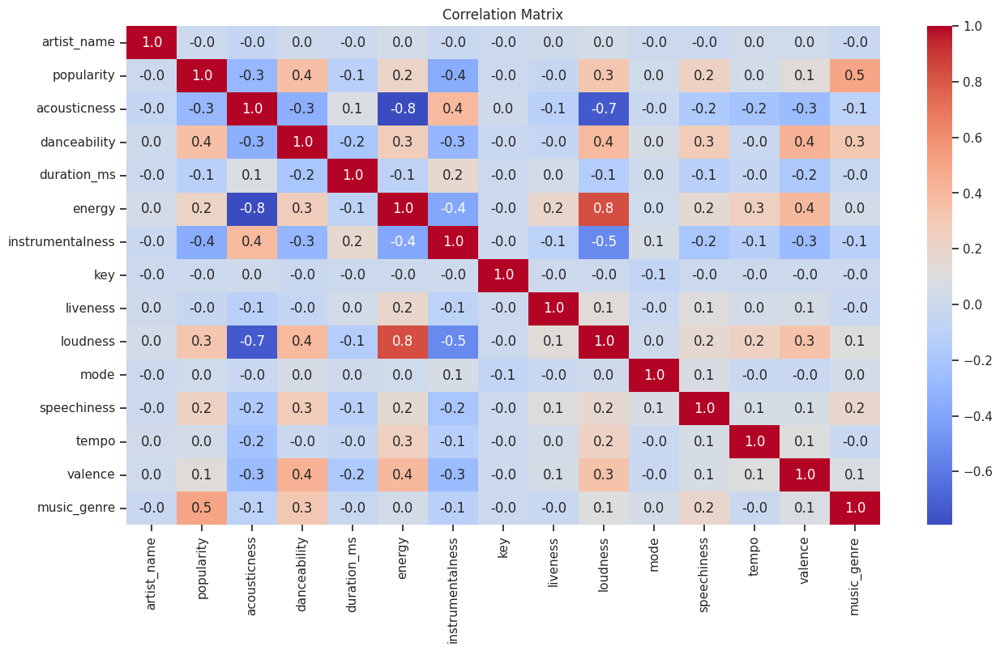

In [110]:
plt.figure(figsize=(15,8))
sns.heatmap(data.corr(), annot=True, cmap='coolwarm',fmt=".1f")
plt.title("Correlation Matrix")

In [111]:
corr_matrix = data.corr()
correlations = corr_matrix['music_genre'].sort_values(ascending=False)
print(correlations)

music_genre         1.000000
popularity          0.503082
danceability        0.302395
speechiness         0.190851
loudness            0.100503
valence             0.076595
mode                0.039173
energy              0.032631
key                -0.011175
tempo              -0.021538
liveness           -0.023377
artist_name        -0.025354
duration_ms        -0.033012
acousticness       -0.095848
instrumentalness   -0.109496
Name: music_genre, dtype: float64



**Q Is the predictor variables independent of all the other predictor variables**

This can be inferred from the correlation matrix.
Energy and loudness are highly correlated with each other with a value of 0.8.
There are also moderately correlated variables such as danceability and valence.



In [119]:
#VIF

import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Assuming 'data' is your DataFrame containing the relevant columns
X = data[['popularity', 'acousticness', 'danceability', 'duration_ms','key','mode','energy',
           'instrumentalness', 'liveness', 'loudness'
          , 'speechiness', 'tempo', 'valence']]

# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X.columns

# Calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                   for i in range(len(X.columns))]

print(vif_data)

             feature        VIF
0         popularity  10.464777
1       acousticness   2.887646
2       danceability  14.025151
3        duration_ms   1.121625
4                key   3.307790
5               mode   1.588517
6             energy  18.938483
7   instrumentalness   2.045262
8           liveness   1.262740
9           loudness   3.664401
10       speechiness   1.365472
11             tempo  14.882732
12           valence   6.569875


Based on both correlation matrix and VIF, energy is highly correlated with loudness and has the most high collinearity value so the energy column can be dropped

In [30]:
data.drop(['energy'],axis=1,inplace=True)
print(data.head())
print(data.info())

   artist_name  popularity  acousticness  danceability  duration_ms  \
1         5895        31.0     -0.246805         0.622    -0.010532   
2         1540        28.0     -0.264925         0.620    -0.039099   
3         1653        34.0     -0.222932         0.774    -0.558626   
4         6283        32.0     -0.261936         0.638     0.032917   
5          453        47.0     -0.260846         0.755     3.199870   

   instrumentalness  key  liveness  loudness  mode  speechiness       tempo  \
1          6.128013    5 -0.013596  0.041059     1    -0.302763  115.002000   
2          0.075110   11  2.773623  0.467646     0    -0.230677  127.994000   
3          0.015303    4  0.210741  0.488570     0     3.045254  128.014000   
4          5.863497    9  0.210741  0.177686     0    -0.121746  145.036000   
5          5.508658    5  0.611829 -0.569808     1    -0.123348  119.874523   

   valence  music_genre  
1    0.531            5  
2    0.333            5  
3    0.270          

In [32]:
#saving cleansed data

data.to_csv('clean_data.csv', index = False)

## **OLS FOR PREDICTOR SIGNIFICANCE**

In [120]:
##Using OLS for finding the p value to check the significant features
import statsmodels.api as sm

model = sm.OLS(data['music_genre'], data[['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'valence']]).fit()

# Print out the statistics
print(model.summary2())

                         Results: Ordinary least squares
Model:                  OLS              Adj. R-squared (uncentered): 0.795      
Dependent Variable:     music_genre      AIC:                         207325.6547
Date:                   2024-04-03 03:38 BIC:                         207438.9597
No. Observations:       45061            Log-Likelihood:              -1.0365e+05
Df Model:               13               F-statistic:                 1.346e+04  
Df Residuals:           45048            Prob (F-statistic):          0.00       
R-squared (uncentered): 0.795            Scale:                       5.8289     
------------------------------------------------------------------------------------
                      Coef.     Std.Err.       t        P>|t|      [0.025     0.975]
------------------------------------------------------------------------------------
popularity            0.0877      0.0008    111.7377    0.0000     0.0861     0.0892
acousticness         -0.0510 

**Inference**

Statistical Significance:
The p-values (P>|t|) associated with each coefficient indicate the probability of observing the coefficient value if the null hypothesis is true (i.e., if the coefficient is zero). A low p-value suggests that the coefficient is statistically significant, meaning it's unlikely to observe such an extreme coefficient value if there's no true relationship between the predictor and the target variable.

Significant Predictors:

popularity: This predictor has a very low p-value (close to 0), indicating strong evidence against the null hypothesis. Thus, popularity appears to be a significant predictor of the music genre.
danceability, duration_ms, energy, instrumentalness, key, liveness, loudness, mode, speechiness, and tempo: These predictors also have very low p-values, indicating that they are statistically significant predictors of the music genre.

Insignificant Predictors:

acousticness and valence: These predictors have p-values greater than the conventional significance level of 0.05. Therefore, we fail to reject the null hypothesis for these predictors, suggesting that they are not statistically significant predictors of the music genre at the 0.05 significance level.

Overall Model Significance: The F-statistic tests the overall significance of the regression model. In this case, the F-statistic is very high, with a corresponding p-value close to 0, indicating that the overall regression model is statistically significant.

# **ML MODELS FORMATION**

##  **PREPROCESSING FOR DATA MODELLING**

Label encoding for data with outliers

In [33]:
#Label encoding on with outlier data


le_key = LabelEncoder()
le_mode = LabelEncoder()
le_genre = LabelEncoder()
le_artistname = LabelEncoder()

# Label encode the categorical variables
datawith_outliers['key'] = le_key.fit_transform(datawith_outliers['key'])
datawith_outliers['mode'] = le_mode.fit_transform(datawith_outliers['mode'])
datawith_outliers['artist_name'] = le_genre.fit_transform(datawith_outliers['artist_name'])
datawith_outliers['music_genre'] = le_genre.fit_transform(datawith_outliers['music_genre'])


# Print class labels for each encoded variable
print("Class labels for 'key':", le_key.classes_)
print("Class labels for 'mode':", le_mode.classes_)
print("Class labels for 'artistname':", le_mode.classes_)
print("Class labels for 'music_genre':", le_genre.classes_)

Class labels for 'key': ['A' 'A#' 'B' 'C' 'C#' 'D' 'D#' 'E' 'F' 'F#' 'G' 'G#']
Class labels for 'mode': ['Major' 'Minor']
Class labels for 'artistname': ['Major' 'Minor']
Class labels for 'music_genre': ['Alternative' 'Anime' 'Blues' 'Classical' 'Country' 'Electronic'
 'Hip-Hop' 'Jazz' 'Rap' 'Rock']


# Dropping target variable music genre

1.Clean data

In [34]:
data.dropna(how='any', inplace=True)

#Limiting the dataset size
sample_size = 30000  # Choose your desired sample size
data_subset = data.sample(n=sample_size, random_state=42)

X = data_subset.drop(columns=['music_genre'])
y = data_subset['music_genre']

2. Data with outliers

In [35]:
#Splitting test and train data set
datawith_outliers.dropna(how='any', inplace=True)

# Limiting the dataset size
sample_size = 30000  # Choose your desired sample size
data_subset = datawith_outliers.sample(n=sample_size, random_state=42)


X_with_outliers = data_subset.drop(columns=['music_genre'])
y_with_outliers = data_subset['music_genre']

In [36]:
feature_names = list(X.columns)
feature_names

['artist_name',
 'popularity',
 'acousticness',
 'danceability',
 'duration_ms',
 'instrumentalness',
 'key',
 'liveness',
 'loudness',
 'mode',
 'speechiness',
 'tempo',
 'valence']

## Splitting the data into train and test in 70/30 ratio

1. Cleaned data

In [37]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.3, stratify = y, random_state =42 )
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(21000, 13) (9000, 13) (21000,) (9000,)


2. Data with outliers

In [38]:
X_train_with_outliers, X_test_with_outliers, y_train_with_outliers, y_test_with_outliers = train_test_split(X_with_outliers, y_with_outliers,test_size=0.3, stratify = y_with_outliers, random_state = 42)
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(21000, 13) (9000, 13) (21000,) (9000,)


**Repeated feature elimination**

In [39]:
#Repeated feature elimination
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier
import pandas as pd



# Initialize a classifier
classifier = RandomForestClassifier()

# Initialize RFE
selector = RFE(estimator=classifier, n_features_to_select=5, step=1)

# Fit RFE to your data and get the selected features
selected_features = selector.fit_transform(X, y)

print("Selected Features:")
print(X.columns[selector.support_])

Selected Features:
Index(['popularity', 'acousticness', 'danceability', 'loudness',
       'speechiness'],
      dtype='object')


The most important features according to repeated feature elimination are

'popularity',
'acousticness',
'danceability',
'loudness',
'speechiness'

## **PERMUTATION IMPORTANCE**

In [40]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.metrics import accuracy_score
# Random Forest
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=7)
rf_classifier.fit(X_train, y_train)
rf_predictions = rf_classifier.predict(X_test)



In [41]:
# Understanding the important features using Permutation Importance
import eli5
from eli5.sklearn import PermutationImportance

perm = PermutationImportance(rf_classifier, random_state=1).fit(X_test, y_test)
eli5.show_weights(perm, feature_names=X_test.columns.tolist())

Weight,Feature
0.2446 ± 0.0070,popularity
0.0773 ± 0.0042,instrumentalness
0.0613 ± 0.0032,danceability
0.0554 ± 0.0033,acousticness
0.0502 ± 0.0069,loudness
0.0488 ± 0.0032,speechiness
0.0312 ± 0.0025,valence
0.0157 ± 0.0046,duration_ms
0.0085 ± 0.0044,artist_name
0.0069 ± 0.0036,tempo


The most important features are popularity,danceability,instrumentalness,acousticness and loudness according to permutation importance

## **TRAINING MODEL METHODS**

## **TREE BASED MODEL**

|                  | Randomforest | ADA (Before HPT) | ADA (After HPT) | XGBoost (Before HPT) | XGBoost (After HPT) |
|------------------|--------------|---------|---------|-------------|-------------|
| Dropping column artist_name |    0.5678    |  0.4841 |  0.5226 |   0.5739    |   0.5896    |
| Encoding column artist_name       |    0.5752    |  0.4753 |  0.5214 |   0.6180    |   0.6296    |

(HPT stands for hyperparameter tuning)


Initially, I had removed around 200 data points where the artist_name was listed as "empty_field" due to its lack of significance. However, upon further consideration,  the names of artists might actually help us predict music genres better. So, instead of getting rid of the artist_name altogether, I decided to keep it and perform encoding,which allowed  to keep the useful information from the artist names while still making it usable for our model.

When I tested different tree models to see which one worked best, I found that XGBoost performed the best out of all of them. It consistently gave the most accurate predictions, especially when combined with the encoded artist_name. This suggests that XGBoost is really good at understanding the complexities of the dataset. By using XGBoost with the artist information,it was possible to make more accurate predictions about music genres compared to other models like Random Forest and ADA. So, based on these results, I decided to go with XGBoost as the preferred model for this classification task due to its highest accuracy

## **XGBOOST**

Performing XGBoost on cleaned data

In [42]:
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score

# Initialize XGBoost classifier
xgb_classifier = xgb.XGBClassifier(random_state=7)

# Fit the classifier to the training data before hyperparameter tuning
xgb_classifier.fit(X_train, y_train)

# Make predictions on the test set before hyperparameter tuning
xgb_predictions_before_tuning = xgb_classifier.predict(X_test)

# Calculate accuracy before hyperparameter tuning
xgb_accuracy_before_tuning = accuracy_score(y_test, xgb_predictions_before_tuning)
print(f"XGBoost Accuracy Before Tuning: {xgb_accuracy_before_tuning:.4f}")

# Define the parameter grid to use for hyperparameter tuning
param_distributions = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 4, 5, 6],
    'min_child_weight': [1, 2, 3],
    'colsample_bytree': [0.3, 0.7, 1],
    'subsample': [0.6, 0.8, 1]
}

# Initialize RandomizedSearchCV with the defined parameters
random_search = RandomizedSearchCV(
    estimator=xgb_classifier,
    param_distributions=param_distributions,
    n_iter=20,
    cv=3,
    scoring='accuracy',
    n_jobs=-1,
    random_state=7
)

# Fit RandomizedSearchCV to the training data
random_search.fit(X_train, y_train)

# Retrieve the best estimator from the random search
best_xgb_classifier = random_search.best_estimator_

# Make predictions on the test set after hyperparameter tuning
xgb_predictions_after_tuning = best_xgb_classifier.predict(X_test)

# Calculate accuracy after hyperparameter tuning
xgb_accuracy_after_tuning = accuracy_score(y_test, xgb_predictions_after_tuning)
print(f"XGBoost Accuracy After Tuning: {xgb_accuracy_after_tuning:.4f}")


XGBoost Accuracy Before Tuning: 0.6180
XGBoost Accuracy After Tuning: 0.6296


## **CONFUSION MATRIX**

<Figure size 800x800 with 0 Axes>

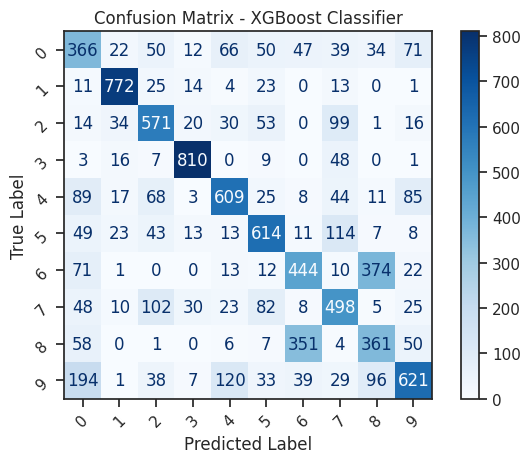

In [43]:
import seaborn as sns
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Generate confusion matrix
conf = confusion_matrix(xgb_predictions_after_tuning, y_test, labels=best_xgb_classifier.classes_)

# Define a custom color map
cmap = sns.color_palette("Blues", as_cmap=True)

# Plot confusion matrix
plt.figure(figsize=(8, 8))
disp = ConfusionMatrixDisplay(confusion_matrix=conf, display_labels=best_xgb_classifier.classes_)
disp.plot(cmap=cmap)
plt.title('Confusion Matrix - XGBoost Classifier')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.tight_layout()
plt.show()


## FEATURE IMPORTANCE USING XGBOOST

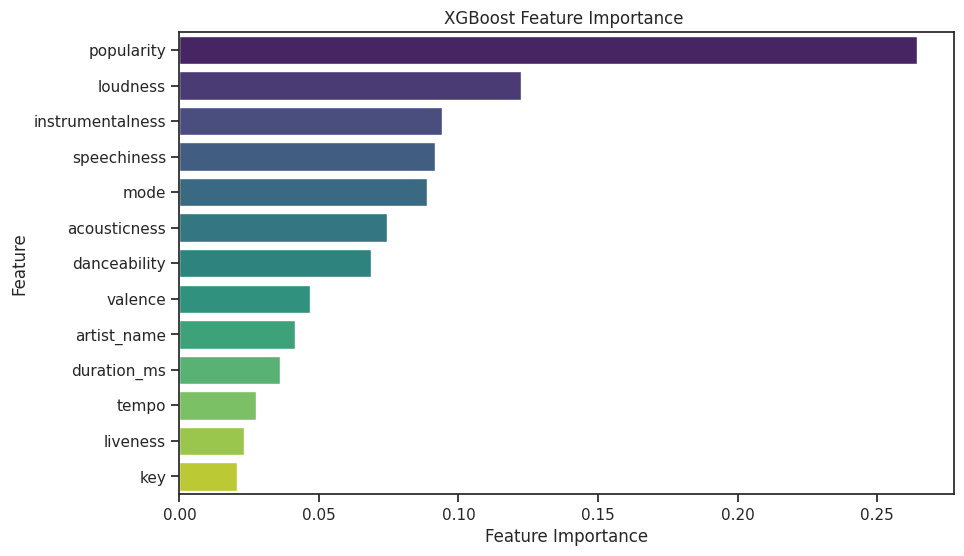

In [44]:
# Get feature importance
feature_importance = best_xgb_classifier.feature_importances_

# Get feature names
feature_names = X_train.columns

# Sort feature importance in descending order
sorted_indices = feature_importance.argsort()[::-1]
sorted_feature_importance = feature_importance[sorted_indices]
sorted_feature_names = [feature_names[i] for i in sorted_indices]

# Visualize sorted feature importance
plt.figure(figsize=(10, 6))
sns.barplot(x=sorted_feature_importance, y=sorted_feature_names, hue=sorted_feature_names, palette='viridis', legend=False)
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('XGBoost Feature Importance ')
plt.show()

The most important features are popularity,loudness, instrumentalness , speechiness, mode

The least important features are key, liveness, tempo,duration, artist_name

## **SHAP ANALYSIS FOR XGBOOST MODEL**

In [45]:
# Importing shap and initializing

import shap

# Initialize JavaScript visualization in the notebook (only needed for Jupyter Notebooks or JupyterLab)
shap.initjs()

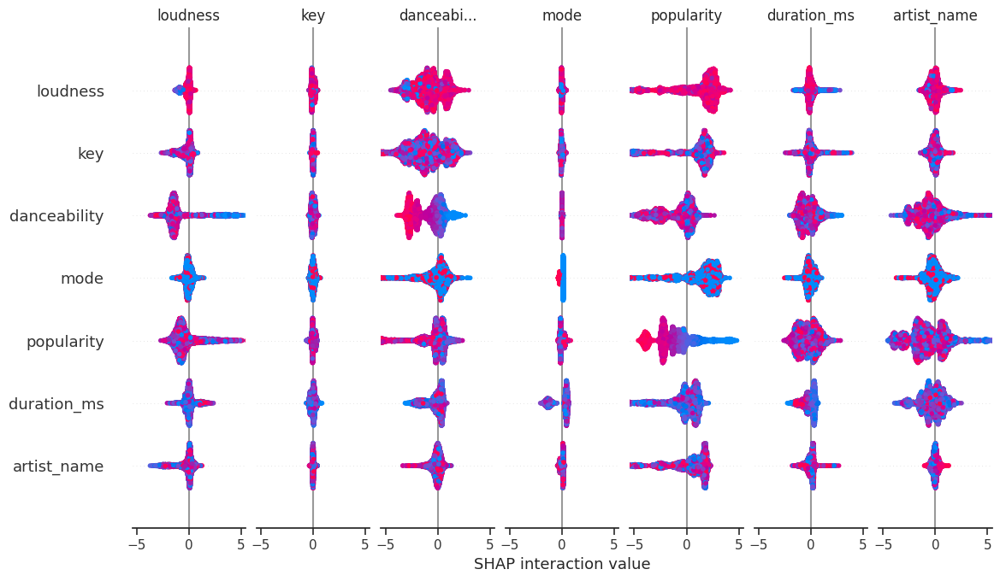

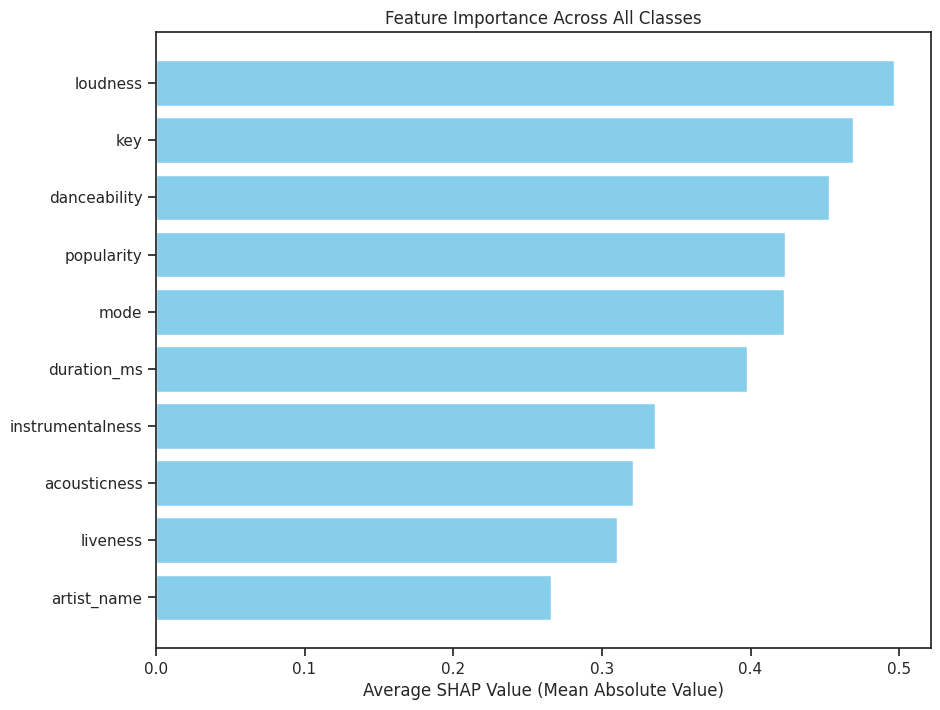

In [46]:


# Create a SHAP explainer object. Here, we are using the Tree explainer specific for tree-based models like XGBoost
explainer = shap.TreeExplainer(best_xgb_classifier)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test)

# To see the impact of each feature on each sample, summary plot is used  without the bar plot type, which shows the SHAP values of every feature for every sample
shap.summary_plot(shap_values, X_test)

import numpy as np
import matplotlib.pyplot as plt

# Calculate the mean absolute SHAP values for each feature across all classes
mean_abs_shap = np.mean([np.abs(shap_matrix).mean(axis=0) for shap_matrix in shap_values], axis=0)

# Get feature names
feature_names = X_test.columns

# Sort the features by importance
sorted_indices = np.argsort(mean_abs_shap)[::-1]

# Create the bar plot
plt.figure(figsize=(10, 8))
plt.barh(range(len(sorted_indices)), mean_abs_shap[sorted_indices], color='skyblue')
plt.yticks(range(len(sorted_indices)), feature_names[sorted_indices])
plt.gca().invert_yaxis()  # To have the most important feature at the top
plt.xlabel('Average SHAP Value (Mean Absolute Value)')
plt.title('Feature Importance Across All Classes')
plt.show()






SHAP Summary Plot (Violin Plot)
 This plot shows the distribution of the SHAP values for each feature across all the data points in the test set. The color represents the value of the feature from low (blue) to high (red).

Features on the top: The features at the top of the plot are the most important ones. In your case, artist_name appears to be the most significant feature for predicting the target variable, followed by liveness, acousticness, and so on.
Impact Direction: Features pushing the prediction higher are shown in red (higher feature values) and those pushing the prediction lower are shown in blue (lower feature values).

Spread of the SHAP Values: The width of the plot shows the range of the impact each feature has on the model's output. A wider area indicates a wider variety of SHAP values, which means the impact of that feature varies more across the predictions.

Vertical Location: The vertical location of each point represents a feature value's impact on the model's prediction for an instance. Points spread out along the y-axis indicate variability in that feature's impact on the model output.

SHAP Bar Plot
It is a bar plot of feature importance, which shows the average impact of each feature on the model's output. The length of the bars represents the mean absolute value of the SHAP values for each feature. Longer bars mean the feature is more important.

Feature Ranking: The features are ordered with the most important feature at the bottom and the least important at the top.

The artist_name is the most influential feature in predicting the outcome, suggesting that who the artist is has a significant impact on the model's predictions. This could be due to the artist's style or genre being highly indicative of the target variable.
Other highly influential features include liveness, acousticness, and instrumentalness, which are characteristics of the music track itself. This suggests that the qualities of the music are also strong predictors.



Performing XGBoost on data with outliers

In [47]:
import xgboost as xgb
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import accuracy_score

# Initialize XGBoost classifier
xgb_classifier = xgb.XGBClassifier(random_state=7)

# Fit the classifier to the training data before hyperparameter tuning
xgb_classifier.fit(X_train_with_outliers, y_train_with_outliers)

# Make predictions on the test set before hyperparameter tuning
xgb_predictions_before_tuning = xgb_classifier.predict(X_test_with_outliers)

# Calculate accuracy before hyperparameter tuning
xgb_accuracy_before_tuning = accuracy_score(y_test, xgb_predictions_before_tuning)
print(f"XGBoost Accuracy Before Tuning: {xgb_accuracy_before_tuning:.4f}")

# Define the parameter grid to use for hyperparameter tuning
param_distributions = {
    'n_estimators': [50, 100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 4, 5, 6],
    'min_child_weight': [1, 2, 3],
    'colsample_bytree': [0.3, 0.7, 1],
    'subsample': [0.6, 0.8, 1]
}

# Initialize RandomizedSearchCV with the defined parameters
random_search = RandomizedSearchCV(
    estimator=xgb_classifier,
    param_distributions=param_distributions,
    n_iter=20,
    cv=3,
    scoring='accuracy',
    n_jobs=-1,
    random_state=7
)

# Fit RandomizedSearchCV to the training data
random_search.fit(X_train_with_outliers, y_train_with_outliers)

# Retrieve the best estimator from the random search
best_xgb_classifier = random_search.best_estimator_

# Make predictions on the test set after hyperparameter tuning
xgb_predictions_after_tuning = best_xgb_classifier.predict(X_test_with_outliers)

# Calculate accuracy after hyperparameter tuning
xgb_accuracy_after_tuning = accuracy_score(y_test_with_outliers, xgb_predictions_after_tuning)
print(f"XGBoost Accuracy After Tuning: {xgb_accuracy_after_tuning:.4f}")


XGBoost Accuracy Before Tuning: 0.6174
XGBoost Accuracy After Tuning: 0.6338


Initially, it was noted that without hyperparameter tuning, the accuracy showed a noticeable increase by approximately 5.13 percentage for data with outliers compared to data without outliers. However, upon closer examination with proper hyperparameter tuning, the difference in accuracy between the XGBoost model trained with and without outliers narrowed significantly to only 0.42 percentage points.

---
## **LINEAR MODEL FITTING**

## **MULTINOMIAL LOGISTIC REGRESSION**

In [48]:


from sklearn.linear_model import LogisticRegression

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler

from sklearn.metrics import accuracy_score

from sklearn.metrics import mean_squared_error

import pandas as pd

# Assuming `X` and `y` are your features and target variable respectively

# and X is a DataFrame with proper column names

# Preprocess the data: scale features

scaler = StandardScaler()

X_scaled = scaler.fit_transform(X)

X_scaled_df = pd.DataFrame(X_scaled, columns=X.columns)  # Convert scaled features back to DataFrame

# Split the data into training and testing sets

X_train, X_test, y_train, y_test = train_test_split(X_scaled_df, y, test_size=0.2, random_state=42)

# Initialize and train the logistic regression model

model_lr = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)

model_lr.fit(X_train, y_train)

# Make predictions and evaluate the model

y_pred = model_lr.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)

print(f"Accuracy: {accuracy}")

# Calculate RMSE for logistic regression model
mse_lr = mean_squared_error(y_test, y_pred)
rmse_lr = np.sqrt(mse_lr)
print(f"RMSE without Ridge regularization: {rmse_lr}")



# Create a DataFrame of coefficients for better interpretation

coef_df = pd.DataFrame(model_lr.coef_, columns=X_train.columns, index=model_lr.classes_)

# Display the DataFrame
print("Coefficients for logistic regression")
print(coef_df)


Accuracy: 0.5285
RMSE without Ridge regularization: 2.832990175297707
Coefficients for logistic regression
   artist_name  popularity  acousticness  danceability  duration_ms  \
0     0.062517    0.888391     -0.314514     -0.148892    -0.183710   
1     0.177455   -3.610165      0.273350     -0.891744    -0.121084   
2     0.087021   -1.962806      0.149905     -0.736986     0.243459   
3    -0.278446   -2.272421      0.785386     -1.623722     0.441772   
4    -0.091525   -0.046462      0.093877      0.061375    -0.691914   
5    -0.045443   -1.370876     -0.572109      0.843720     0.421723   
6     0.019056    2.866432     -0.327005      1.483240    -0.225428   
7    -0.107809   -0.827105      0.660112      0.088146     0.421216   
8     0.118173    3.313824     -0.372722      1.326134    -0.293223   
9     0.059002    3.021188     -0.376281     -0.401271    -0.012810   

   instrumentalness       key  liveness  loudness      mode  speechiness  \
0          0.178680  0.007588 -0.02

**Visualizing the coeeficients for logistic regression**

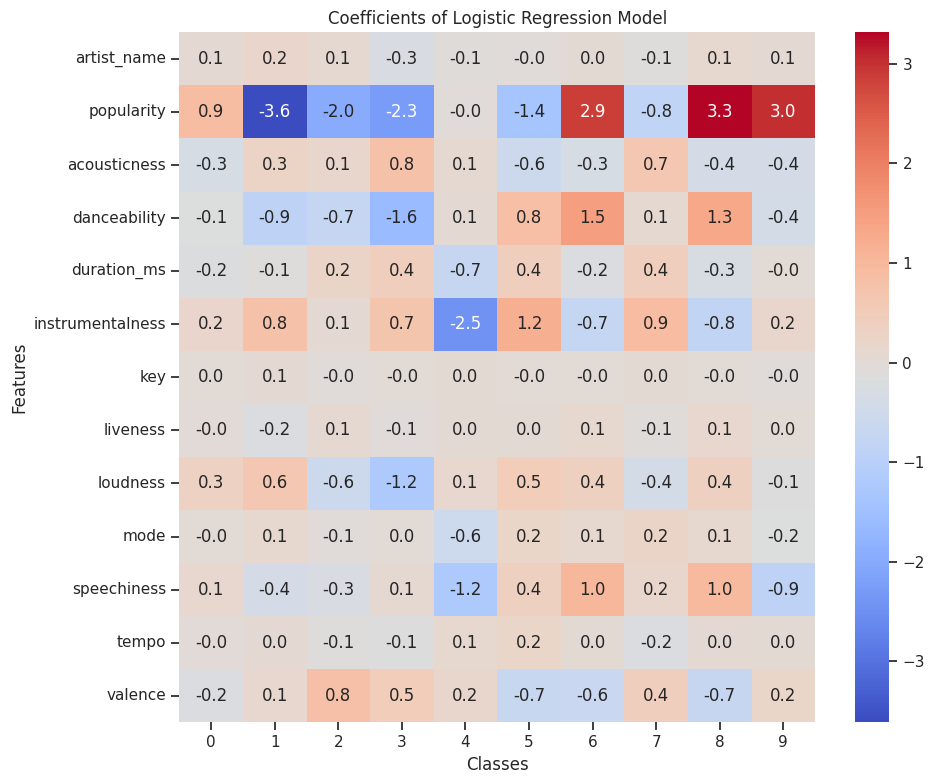

In [49]:
import seaborn as sns

coef_df_transposed=coef_df.T
# Plotting heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(coef_df_transposed, cmap='coolwarm', annot=True, fmt=".1f")
plt.title('Coefficients of Logistic Regression Model')
plt.xlabel('Classes')
plt.ylabel('Features')
plt.tight_layout()
plt.show()

In [50]:
# Assuming le_genre is your LabelEncoder object for 'music_genre'

# Create a DataFrame to display the mapping of encoded values to music genres
genre_mapping_df = pd.DataFrame({'Encoded Label': range(len(le_genre.classes_)),
                                 'Music Genre': le_genre.classes_})

# Print the DataFrame
print(genre_mapping_df)

   Encoded Label  Music Genre
0              0  Alternative
1              1        Anime
2              2        Blues
3              3    Classical
4              4      Country
5              5   Electronic
6              6      Hip-Hop
7              7         Jazz
8              8          Rap
9              9         Rock


**Analysis for Logistic Regression Coefficients**

The above shows coefficients received from the logistic regression model.
Each row in the output corresponds to a different class (music genre), and each column represents a feature (such as popularity, acousticness, danceability, etc.)

The magnitude of the coefficients indicates the strength of the association between each feature and the predicted genre label.

Instrumentalness:
 The coefficient for instrumentalness has a relatively large positive value, indicating that the presence of instrumental elements in the music is a strong predictor for certain genres. Genres such as Classical and Jazz, which typically feature instrumental compositions, may have higher probabilities with increasing instrumentalness.

Popularity:
 The coefficient for popularity also has a substantial positive value, suggesting that the popularity of a track is an important predictor for genre classification. More popular tracks may be associated with specific genres like Rock or Hip-Hop.

Loudness:
 A positive coefficient for loudness indicates that louder tracks may be associated with certain genres, potentially those with a more energetic or aggressive sound, such as Rock or Hip-Hop.

Danceability:
Positive coefficients for danceability suggest that more danceable tracks may be associated with specific genres like Electronic or Pop.

Acousticness:
Positive coefficients for acousticness suggest that higher levels of acoustic elements in the music may be associated with certain genres like Blues or Folk.

Valence:
Positive coefficients for valence suggest that tracks with a more positive mood may be associated with specific genres like Pop or Country.

Speechiness:
 Positive coefficients for speechiness suggest that tracks with more spoken-word elements may be associated with certain genres like Rap or Hip-Hop.

Tempo:
 Positive coefficients for tempo indicate that faster tempo tracks may be associated with specific genres like Electronic or Dance music.

Duration:
 The coefficient for duration has a relatively small magnitude, suggesting that the length of the track may have a less pronounced impact on genre classification compared to other features.

Mode:
The coefficient for mode has a relatively small magnitude, suggesting that the musical mode (major or minor) may have a less significant impact on genre classification compared to other features.

Artist Name:
The coefficient for artist name also has a relatively small magnitude, indicating that the influence of the artist's name on genre classification may be less pronounced compared to other features.

**Inference based on coefficients**

Based on the above interpretations, **instrumentalness, popularity, loudness, danceability, and acousticness** appear to be among the most important features in predicting the probability of each music genre label. These features show strong associations with specific genres and could significantly influence the genre classification process.

## **CONFUSION MATRIX**

<Figure size 800x800 with 0 Axes>

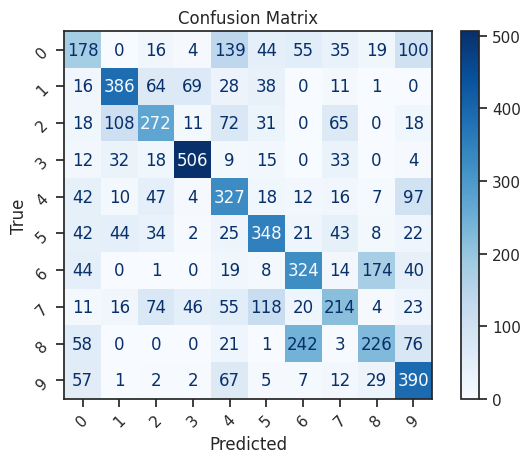

In [51]:
# Compute confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

# Plot confusion matrix
plt.figure(figsize=(8, 8))
disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix, display_labels=np.unique(y_test))
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')
plt.xticks(rotation=45)
plt.yticks(rotation=45)
plt.tight_layout()
plt.show()

## REGULARIZATION

**RIDGE REGULARIZATION**

In [52]:
from sklearn.linear_model import Ridge
from sklearn import metrics
# Apply Ridge regularization
# Ridge regression with an alpha of 0.5
ridge = Ridge(fit_intercept=True, alpha=0.5)
ridge.fit(X_train, y_train)
Ridge(alpha=0.5)
# rmse after regularization
y_pred = ridge.predict(X_test)

rmse = np.sqrt(metrics.mean_squared_error(y_test, y_pred))
rmse

2.3911848017970634

The rmse value before regularization was 2.83. Upon performing ridge regularization on the logistic regression model, the rmse came down to 2.39 which shows only a decrease of 0.44 percent which is not highly significant

## **SHAP ANALYSIS FOR LOGISTIC REGRESSION MODEL**

<Figure size 800x800 with 0 Axes>

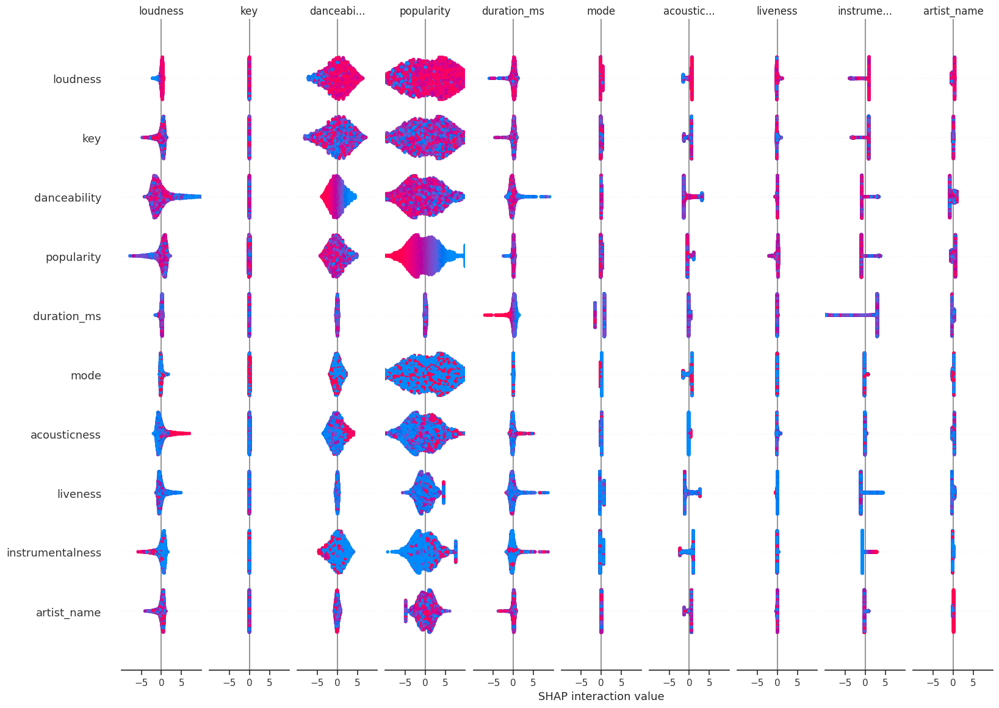

In [54]:
# Create SHAP explainer
explainer = shap.Explainer(model_lr, X_train)  # Adjust the approximate parameter if necessary

# Calculate SHAP values
shap_values = explainer.shap_values(X_test)

plt.figure(figsize=(8, 8))  # You can adjust the size as needed
shap.summary_plot(shap_values, X_test, feature_names=X_test.columns, max_display=X_test.shape[1])
plt.show()

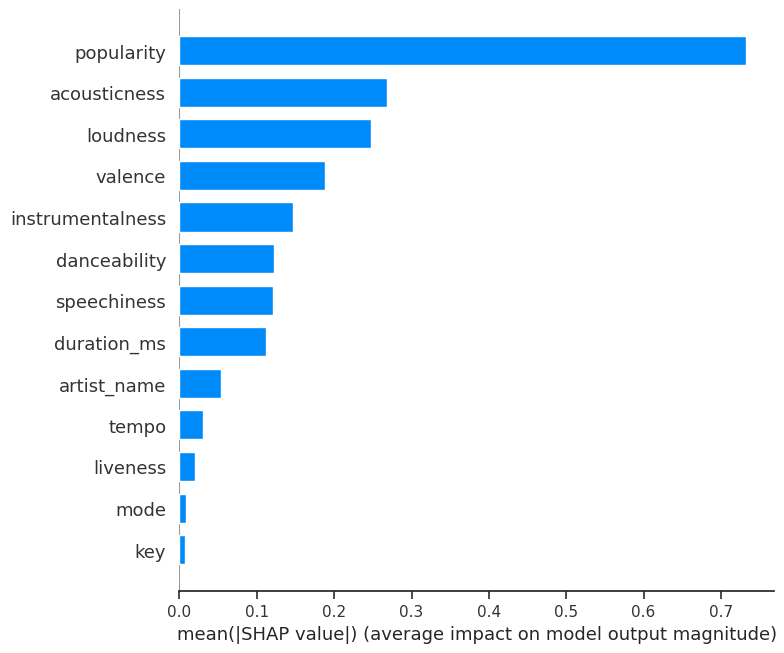

In [55]:
# Calculate the mean SHAP values across output classes (for multi-class classification)
mean_shap_values = np.abs(shap_values).mean(axis=0)
# Selecting a specific class ( class 0 - Alternative)
shap_values_class_0 = mean_shap_values[:, 0]

# Reshape shap_values_class_0 to match the required format
shap_values_class_0_matrix = shap_values_class_0.reshape(-1, len(X_test.columns))

# Plot SHAP values for the selected class
plt.figure(figsize=(10, 8))
shap.summary_plot(shap_values_class_0_matrix, X_test, plot_type="bar", feature_names=X_test.columns)
plt.show()

From the above shap analysis for Alternative Genre, the most important feature is again popularity and mode and key appear to be the features that have least impact on the output.
Below are the impact of each feature on this particular genre

Popularity:
Popularity has the most significant positive impact on the model’s output within this class.
Higher popularity values lead to increased predictions for songs in the Alternative genre.

Acousticness:
Acousticness has a moderate impact, but it is less influential compared to popularity.
Songs with higher acousticness may contribute positively to the model’s predictions.

Loudness:
Loudness also has a noticeable impact, although not as strong as popularity.
Positive loudness values tend to boost predictions.

Valence:
Valence (positiveness) has a moderate impact.
Songs with higher valence contribute positively to the model’s output.

Danceability:
Danceability contributes positively to the model’s predictions.
More danceable songs tend to receive higher predictions.

Instrumentalness:
Instrumentalness has a smaller impact, but there are instances where it significantly affects predictions.
High instrumentalness values may lead to higher model predictions.

Speechiness:
Speechiness has a balanced impact; it can both increase or decrease predictions.
Instances with high speechiness may contribute positively.

Duration (duration_ms):
Duration has a moderate impact, with both positive and negative effects.
Longer durations may contribute positively, while shorter durations may have a negative impact.

Tempo:
Tempo (beats per minute) has a moderate impact.
Faster tempos may lead to higher predictions.

Liveness:
Liveness has minimal impact overall.
For most instances, liveness doesn’t significantly influence predictions.

Mode:
The “Mode” feature (major vs. minor) has negligible impact.
It almost doesn’t affect the model’s output.

Key:
The “Key” feature also has very little impact.
Different keys contribute similarly to the model’s predictions.

## **Performing Logistic Regression on data with outliers**

## **LOGISTIC REGRESSION**

In [56]:


from sklearn.linear_model import LogisticRegression

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import StandardScaler

from sklearn.metrics import accuracy_score

from sklearn.metrics import mean_squared_error

import pandas as pd

# Assuming `X` and `y` are your features and target variable respectively

# and X is a DataFrame with proper column names

# Preprocess the data: scale features

scaler = StandardScaler()

X_scaled = scaler.fit_transform(X_with_outliers)

X_scaled_df = pd.DataFrame(X_scaled, columns=X_with_outliers.columns)  # Convert scaled features back to DataFrame

# Split the data into training and testing sets

X_train_with_outliers, X_test_with_outliers, y_train_with_outliers, y_test_with_outliers = train_test_split(X_scaled_df, y_with_outliers, test_size=0.2, random_state=42)

# Initialize and train the logistic regression model

model_lr = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)

model_lr.fit(X_train_with_outliers, y_train_with_outliers)

# Make predictions and evaluate the model

y_pred = model_lr.predict(X_test_with_outliers)

accuracy = accuracy_score(y_test_with_outliers, y_pred)

print(f"Accuracy: {accuracy}")

# Calculate RMSE for logistic regression model
mse_lr = mean_squared_error(y_test_with_outliers, y_pred)
rmse_lr = np.sqrt(mse_lr)
print(f"RMSE : {rmse_lr}")






Accuracy: 0.5318333333333334
RMSE : 2.8279556809351405


## **INFERENCES**

|                   | XGBoost                             | Logistic Regression |
|-------------------|-----------------------------------  |----------|
| Without outliers | Before HPT: 0.6180; After HPT: 0.6296        | 0.5285   |
| With outliers    | Before HPT: 0.6174; After HPT : 0.6338        | 0.5318   |

(HPT stands for hyperparameter tuning)

For the logistic regression, the accuracy for the model with outliers is only higher than model without outliers by 0.33 points which is not highly significant

After conducting hyperparameter tuning, it was observed that the performance of the models with and without outliers became nearly identical, with the former showing just a slight improvement. This finding underscores the importance of fine-tuning model parameters to achieve optimal performance, as it allowed for the mitigation of any potential adverse effects of outliers on the model's accuracy. Thus, the marginal difference in accuracy between the two scenarios was only noticeable after the refinement of hyperparameters, highlighting the significance of this optimization step in model development.

---

## **AUTOML**

AutoML H2O imports and initialization

In [57]:
!pip install requests
!pip install tabulate
!pip install "colorama>=0.3.8"
!pip install future

In [58]:
!pip install -f http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html h2o

Looking in links: http://h2o-release.s3.amazonaws.com/h2o/latest_stable_Py.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 265.6/265.6 MB 3.7 MB/s eta 0:00:00


In [59]:
import h2o
from h2o.automl import H2OAutoML
import random, os, sys
import psutil

In [60]:
# Setting the minimum memory size to allocate for H2O (in GB)
min_mem_size = 6
# Setting the desired runtime
run_time = 400

In [61]:
# Percentage of available memory to allocate for H2O
pct_memory = 0.5
# Retrieving information about the available system memory
virtual_memory = psutil.virtual_memory()
# Calculating the minimum memory size for H2O based on the percentage of available memory
min_mem_size = int(round(int(pct_memory * virtual_memory.available) / 1073741824, 0))
# Printing the calculated minimum memory size
print(min_mem_size)

5


In [62]:
# Generating a random port number between 5555 and 55555 for H2O communication
port_no = random.randint(5555, 55555)

# Attempting to initialize H2O with the specified parameters
try:
    # Initializing H2O with the provided parameters
    h2o.init(strict_version_check=False, min_mem_size_GB=min_mem_size, port=port_no)
except:
    print("Error initializing H2O.")
    sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:45133..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpza3z4jra
  JVM stdout: /tmp/tmpza3z4jra/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpza3z4jra/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:45133
Connecting to H2O server at http://127.0.0.1:45133 ... successful.


H2O_cluster_uptime:,05 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_g46qsw
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,5 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [63]:
# Import the processed data
data.to_csv('preprocesseddata.csv',index=False)
url='preprocesseddata.csv'
df=h2o.import_file(url)
df.head()

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


artist_name,popularity,acousticness,danceability,duration_ms,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,valence,music_genre
5895,31,-0.246805,0.622,-0.0105317,6.12801,5,-0.0135962,0.0410586,1,-0.302763,115.002,0.531,5
1540,28,-0.264925,0.62,-0.0390994,0.0751097,11,2.77362,0.467646,0,-0.230677,127.994,0.333,5
1653,34,-0.222932,0.774,-0.558626,0.0153032,4,0.210741,0.48857,0,3.04525,128.014,0.27,5
6283,32,-0.261936,0.638,0.0329168,5.8635,9,0.210741,0.177686,0,-0.121746,145.036,0.323,5
453,47,-0.260846,0.755,3.19987,5.50866,5,0.611829,-0.569808,1,-0.123348,119.875,0.614,5
2904,46,-0.216353,0.572,-0.0519442,-0.000969419,2,-0.135962,0.524442,0,4.83941,149.995,0.23,5
2433,43,-0.21485,0.809,2.09835,5.82479,10,-0.424881,-0.362669,1,-0.00800961,120.008,0.761,5
3071,39,-0.265056,0.509,0.783682,0.00076129,8,0.353501,0.721206,1,3.50981,149.948,0.273,5
5027,22,-0.25312,0.578,-0.154362,0.0712387,0,-0.101971,0.0326183,1,1.98799,139.933,0.203,5
1070,30,1.33647,0.607,-0.52038,-0.00101935,9,-0.135962,-1.1448,1,-0.230677,57.528,0.307,5


In [64]:
# Create a 80/20 train/test split
pct_rows=0.80
df_train, df_test = df.split_frame([pct_rows])

In [65]:
#Display all columns in X
X=df.columns
print(X)

['artist_name', 'popularity', 'acousticness', 'danceability', 'duration_ms', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'valence', 'music_genre']


In [66]:
#Seperate Dependent variable from Independent variable
y_target ='music_genre'
X.remove(y_target)
print(X)

['artist_name', 'popularity', 'acousticness', 'danceability', 'duration_ms', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'speechiness', 'tempo', 'valence']


In [67]:
# Convert the target variable to a categorical factor in the training set
df_train[y_target] = df_train[y_target].asfactor()

In [68]:

# Set up AutoML
aml =  H2OAutoML(max_runtime_secs=run_time, seed=1)

In [69]:
#passing the data through H20AutoML
aml.train(x=X,y=y_target,training_frame=df_train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),3/3
# GBM base models (used / total),1/1
# XGBoost base models (used / total),1/1
# GLM base models (used / total),1/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None
Custom metalearner hyperparameters,None


**Interpreting the AutoML results**

Three base models were used: one GBM (Gradient Boosting Machine), one XGBoost, and one GLM (Generalized Linear Model).
The metalearner algorithm used for the stacked ensemble is GLM.

MSE (Mean Squared Error): A measure of the average squared difference between the actual and predicted values.

RMSE (Root Mean Squared Error): The square root of the MSE, providing an interpretable measure in the same units as the target variable.

LogLoss: Logarithmic loss, which measures the performance of a classification model where the prediction output is a probability value.

Confusion Matrix: A table showing the counts of true positive, true negative, false positive, and false negative predictions across different classes.

Top-10 Hit Ratios: Hit ratios at different levels of top-k predictions.

The model performs reasonably well on both the training and cross-validation data, as indicated by the relatively low values of MSE, RMSE, and LogLoss.

Confusion Matrix provides insights into the model's performance across different classes.

Top-10 Hit Ratio indicates the model's accuracy at predicting the correct class within the top-k predictions.
Higher hit ratios suggest better predictive performance.

Cross-Validation Metrics Summary gives an overview of the model's performance across different cross-validation folds.The main model used is a Stacked Ensemble, which is an ensemble of other models. The stacking strategy used is cross-validation.


In [70]:
# Get the leaderboard
lb=aml.leaderboard
print(lb)

model_id                                                  mean_per_class_error    logloss      rmse       mse
StackedEnsemble_BestOfFamily_1_AutoML_1_20240403_22523                0.386311    1.0155   0.583801  0.340824
GBM_1_AutoML_1_20240403_22523                                         0.409131    1.07872  0.615157  0.378418
XGBoost_1_AutoML_1_20240403_22523                                     0.415753    1.12207  0.626566  0.392585
GLM_1_AutoML_1_20240403_22523                                         0.522564    1.72435  0.805903  0.649479
[4 rows x 5 columns]



The StackedEnsemnle Model has the least mean per class error , log loss, rmse and mse indicating that it's the best model as it outperforms individual base models (GBM, XGBoost, and GLM) in terms of classification accuracy and predictive performance and out of the individual models, GBM is the best since it has the lowest mean per class error compared to the other base models.

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

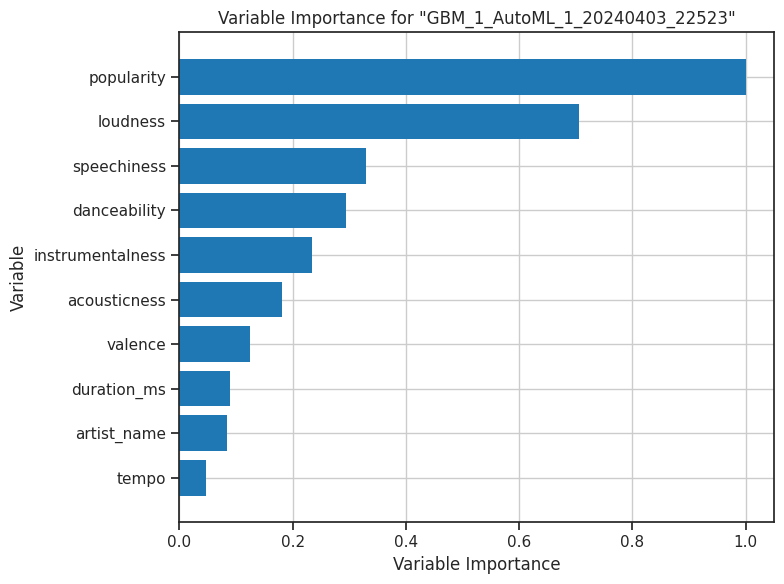

In [71]:
explain_model = aml.explain(frame = df_test, figsize = (8,6),include_explanations=['varimp'])

From variable importance, it is lear that highly important variables are popularity, loudness, speechiness and danceability followed by others as shown in the plot.

**Finding the best model**

In [72]:
# Access the best model
best_model = aml.leader

# Show model details
print("Model type:", type(best_model))  # Display the type of the best model
print("Model summary:")
print(best_model)  # Display the summary of the best model

Model type: <class 'h2o.estimators.stackedensemble.H2OStackedEnsembleEstimator'>
Model summary:
Model Details
H2OStackedEnsembleEstimator : Stacked Ensemble
Model Key: StackedEnsemble_BestOfFamily_1_AutoML_1_20240403_22523


Model Summary for Stacked Ensemble: 
key                                   value
------------------------------------  ----------------
Stacking strategy                     cross_validation
Number of base models (used / total)  3/3
# GBM base models (used / total)      1/1
# XGBoost base models (used / total)  1/1
# GLM base models (used / total)      1/1
Metalearner algorithm                 GLM
Metalearner fold assignment scheme    Random
Metalearner nfolds                    5
Metalearner fold_column
Custom metalearner hyperparameters    None

ModelMetricsMultinomialGLM: stackedensemble
** Reported on train data. **

MSE: 0.4770433019362154
RMSE: 0.6906832138804413
LogLoss: 1.2712387717250366
Null degrees of freedom: 10061
Residual degrees of freedom: 9807
Null

In [73]:
# Show model performance metrics
print("Model performance metrics:")
performance_metrics = best_model.model_performance()
print(performance_metrics)  # Display the performance metrics of the best model

Model performance metrics:
ModelMetricsMultinomialGLM: stackedensemble
** Reported on train data. **

MSE: 0.4770433019362154
RMSE: 0.6906832138804413
LogLoss: 1.2712387717250366
Null degrees of freedom: 10061
Residual degrees of freedom: 9807
Null deviance: 46336.723644877886
Residual deviance: 25582.40904219464
AUC table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).
AUCPR table was not computed: it is either disabled (model parameter 'auc_type' was set to AUTO or NONE) or the domain size exceeds the limit (maximum is 50 domains).

Confusion Matrix: Row labels: Actual class; Column labels: Predicted class
0     1     2    3     4    5     6     7    8    9    Error      Rate
----  ----  ---  ----  ---  ----  ----  ---  ---  ---  ---------  --------------
717   19    5    11    37   15    109   2    2    69   0.272819   269 / 986
22    914   16   58    7    6     2     0    0   

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_1_AutoML_1_20240403_22523

0,1,2,3,4,5,6,7,8,9,Error,Rate
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
9.0,3.0,5.0,2.0,1.0,71.0,6.0,1.0,1.0,1.0,0.29,29 / 100
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

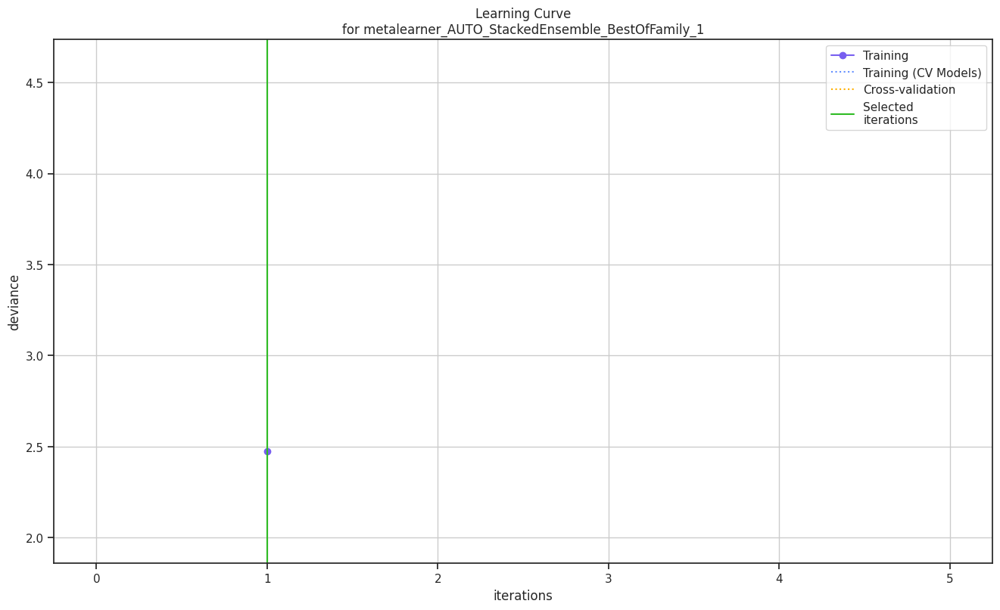

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

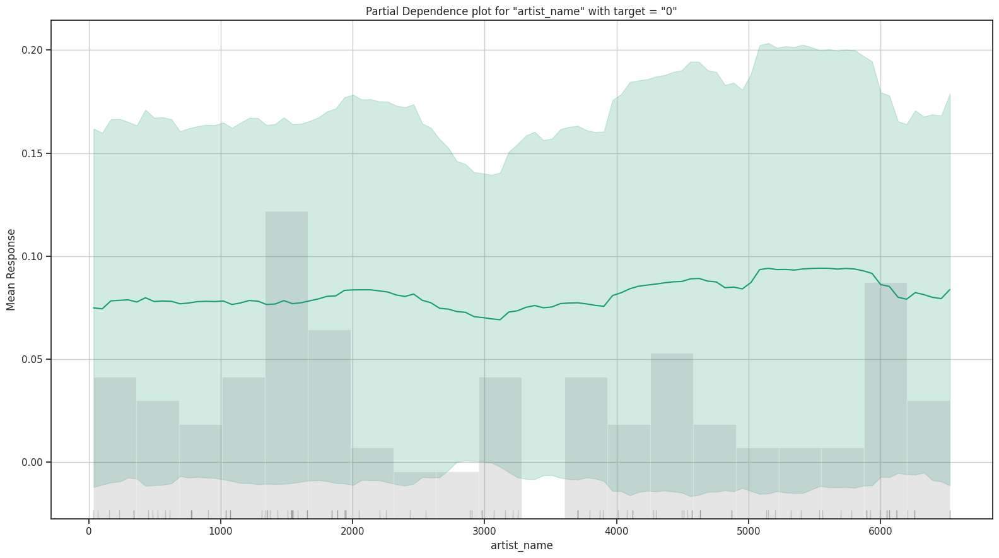

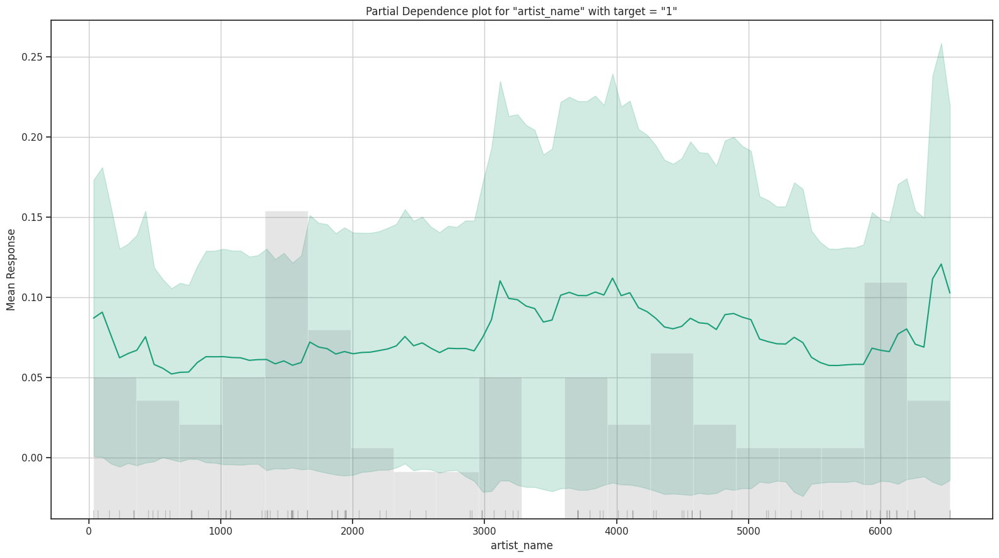

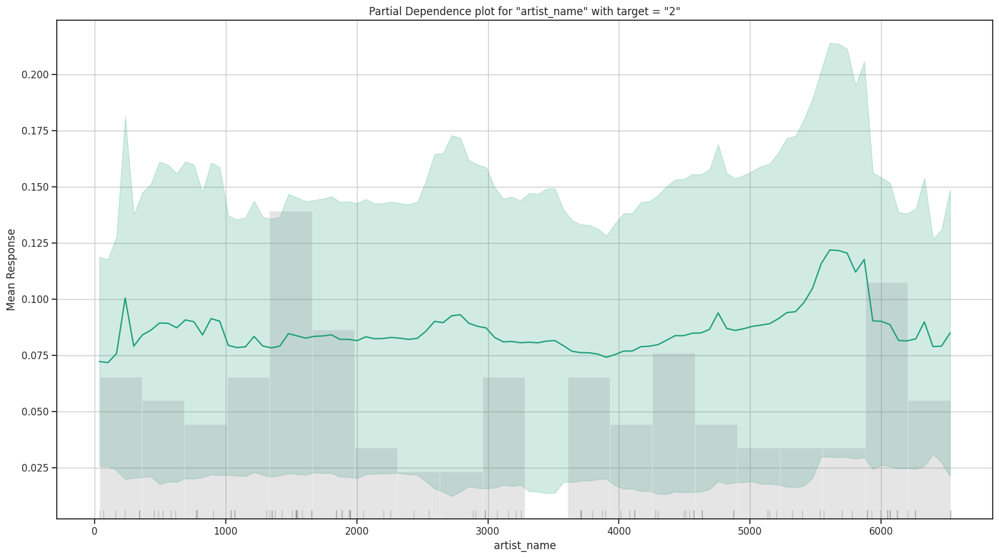

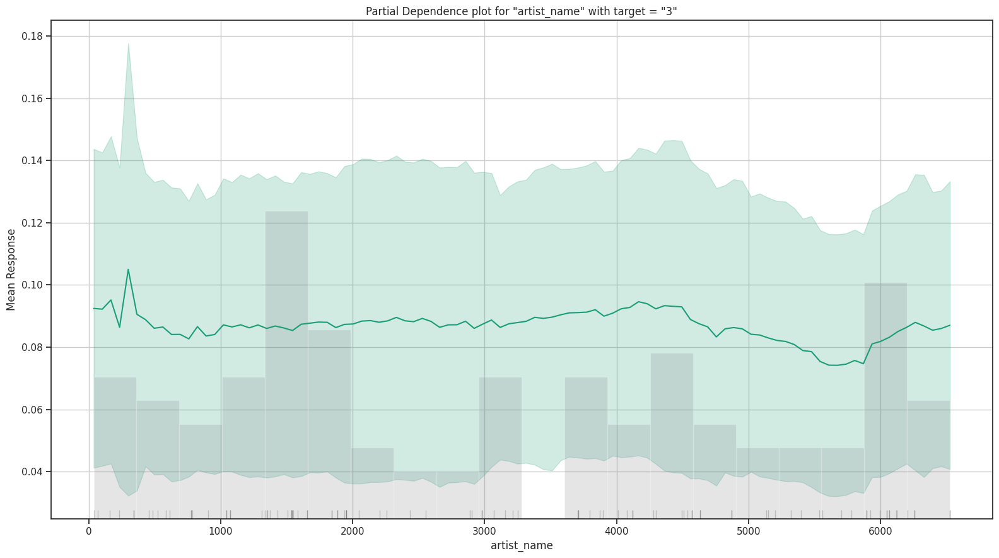

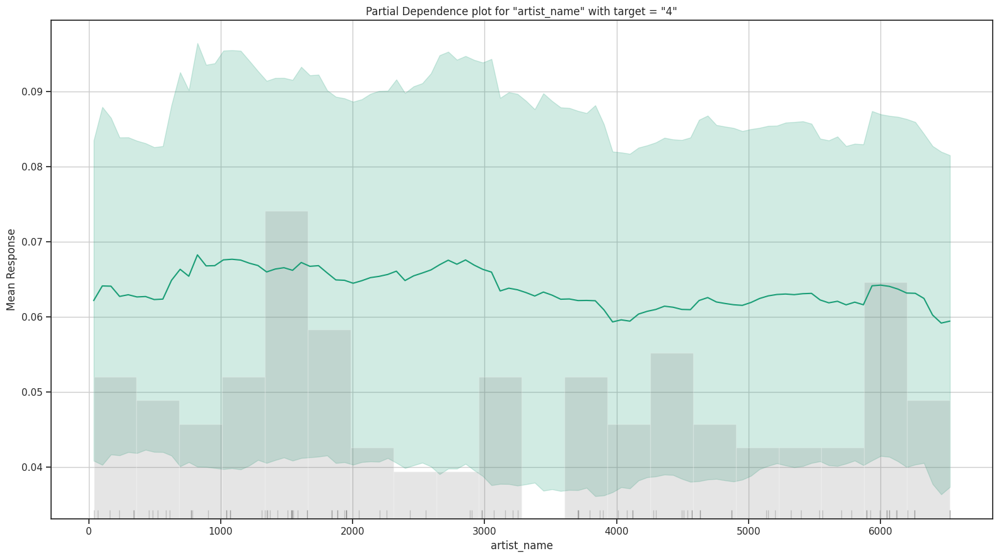

...

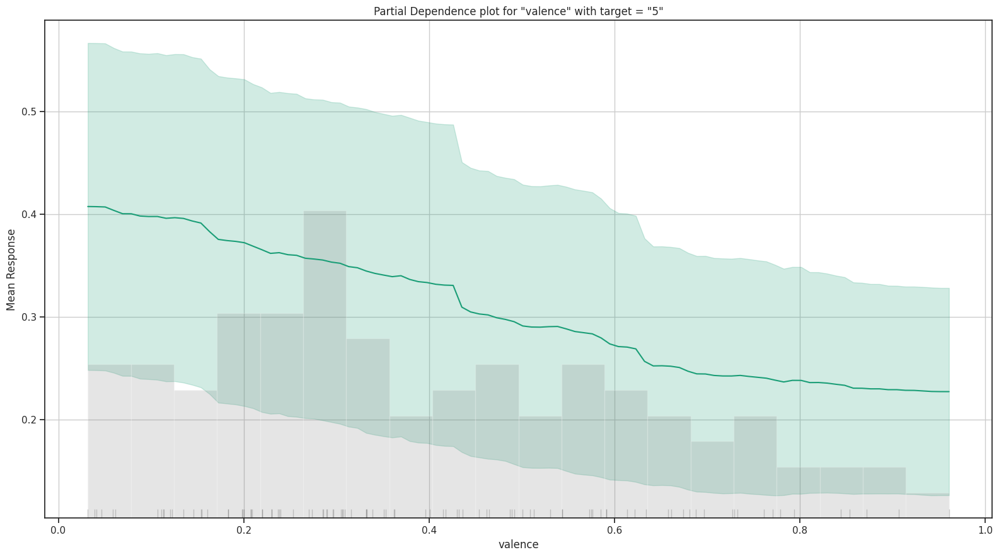

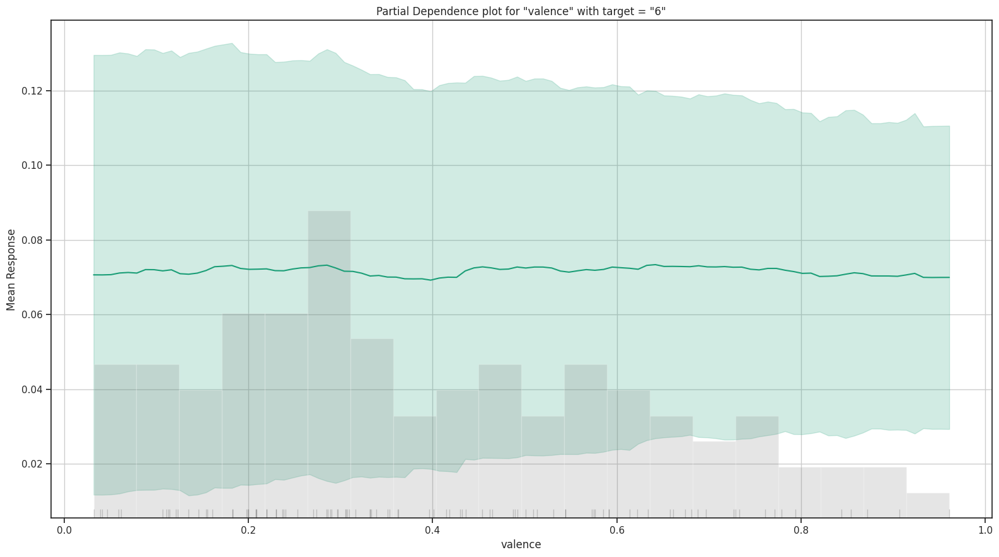

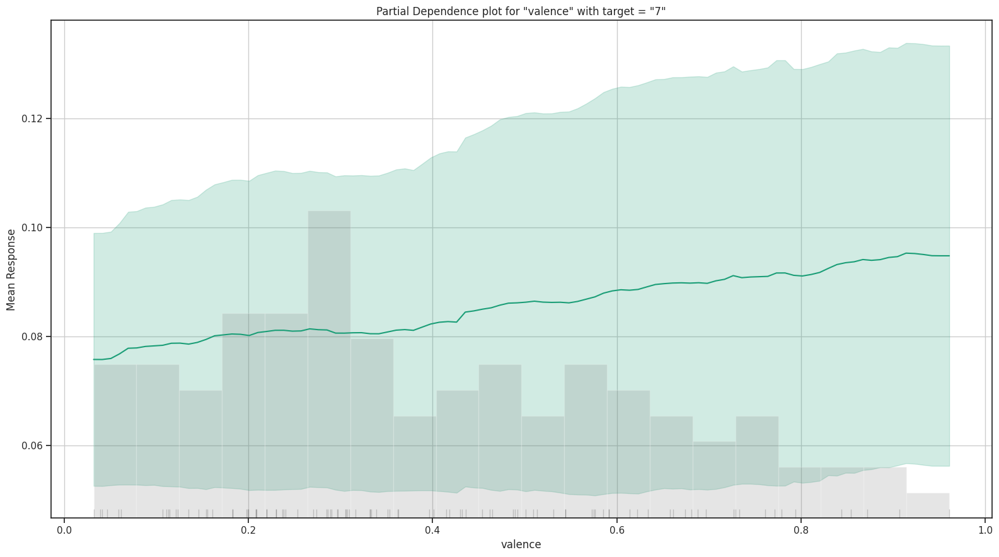

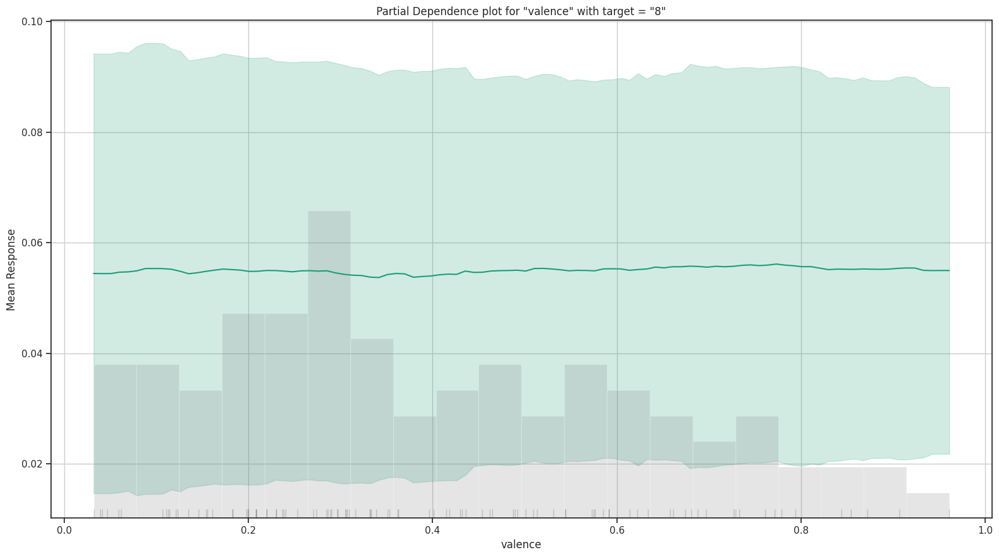

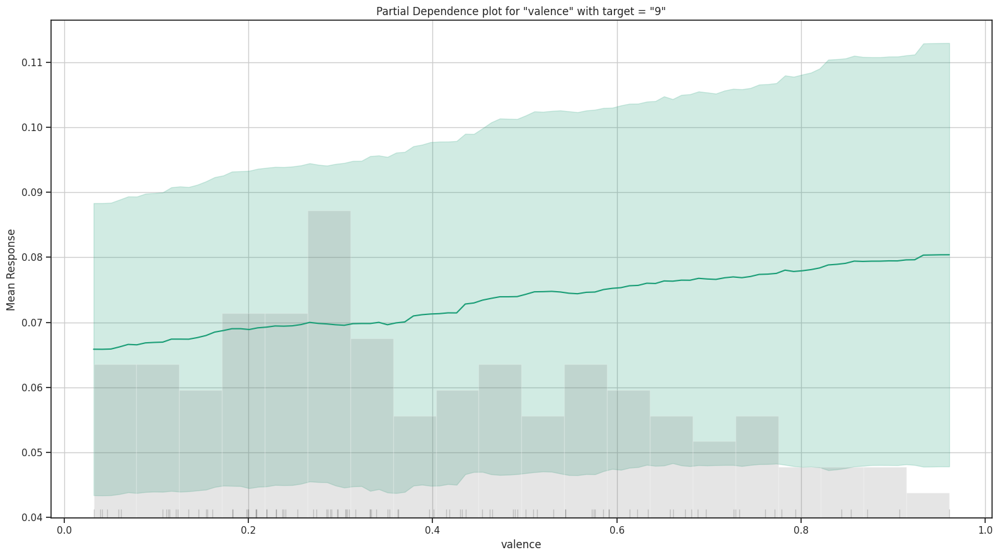

# Confusion Matrix

> Confusion matrix shows a predicted class vs an actual class.

## StackedEnsemble_BestOfFamily_1_AutoML_1_20240403_22523

0,1,2,3,4,5,6,7,8,9,Error,Rate
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
9.0,3.0,5.0,2.0,1.0,71.0,6.0,1.0,1.0,1.0,0.29,29 / 100
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0
0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,nan,0 / 0


# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

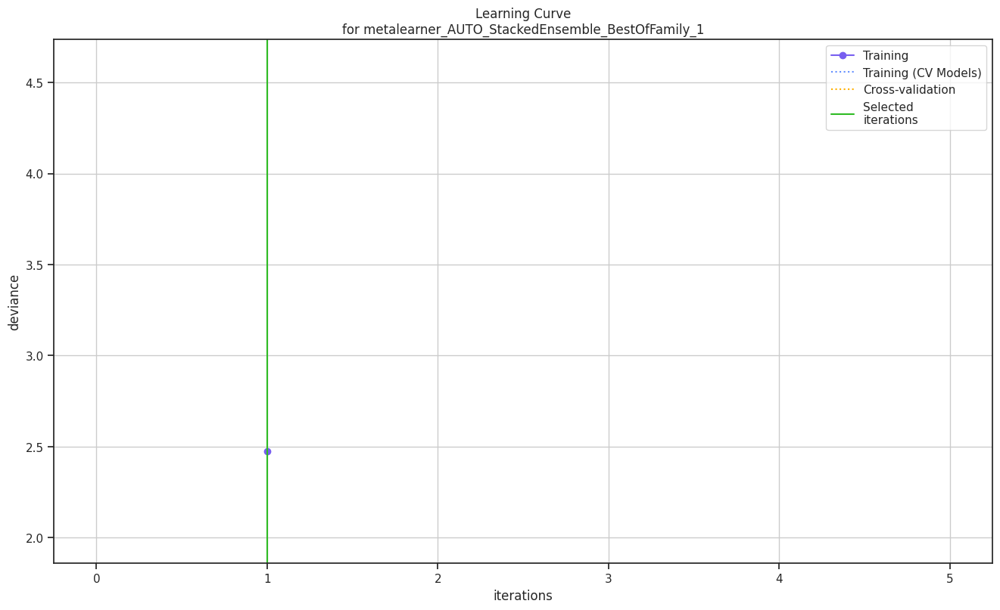

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

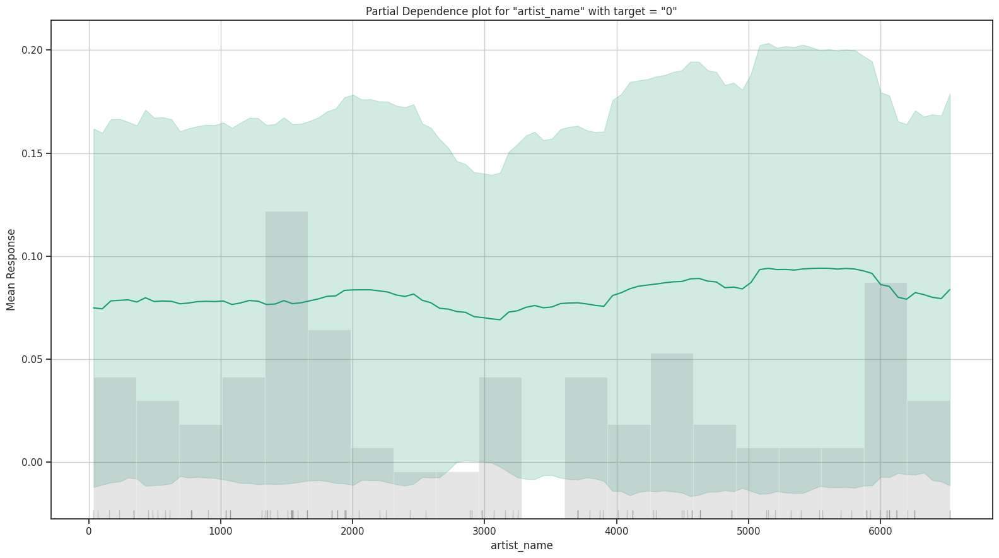

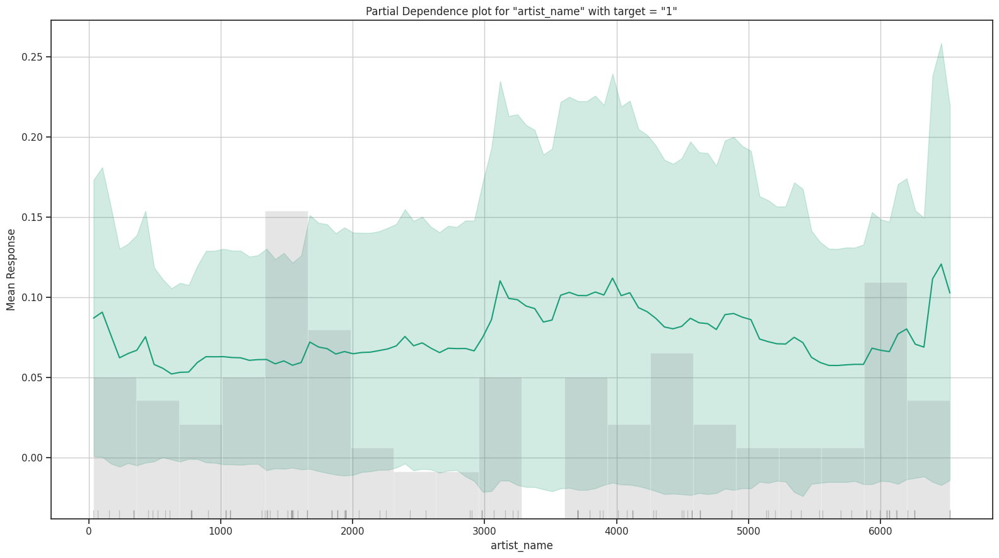

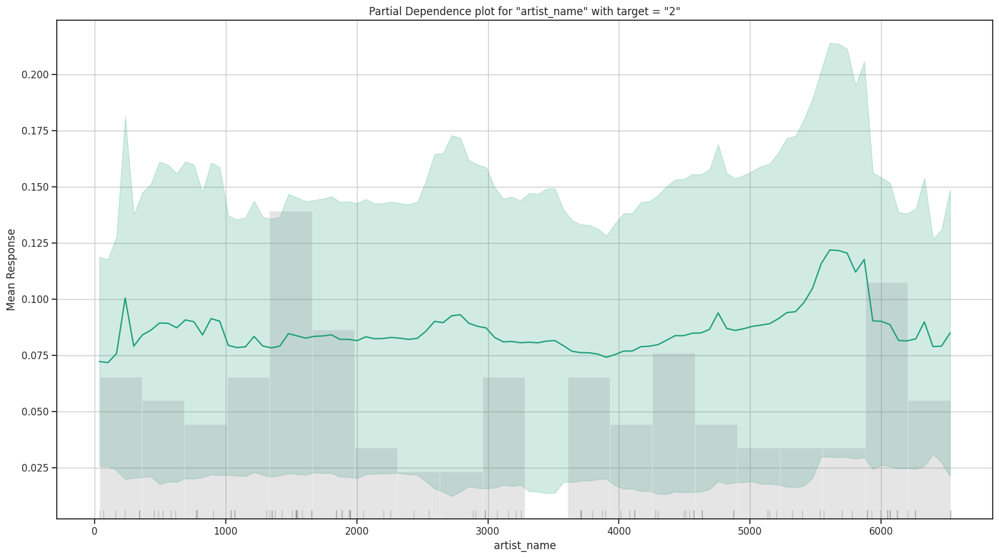

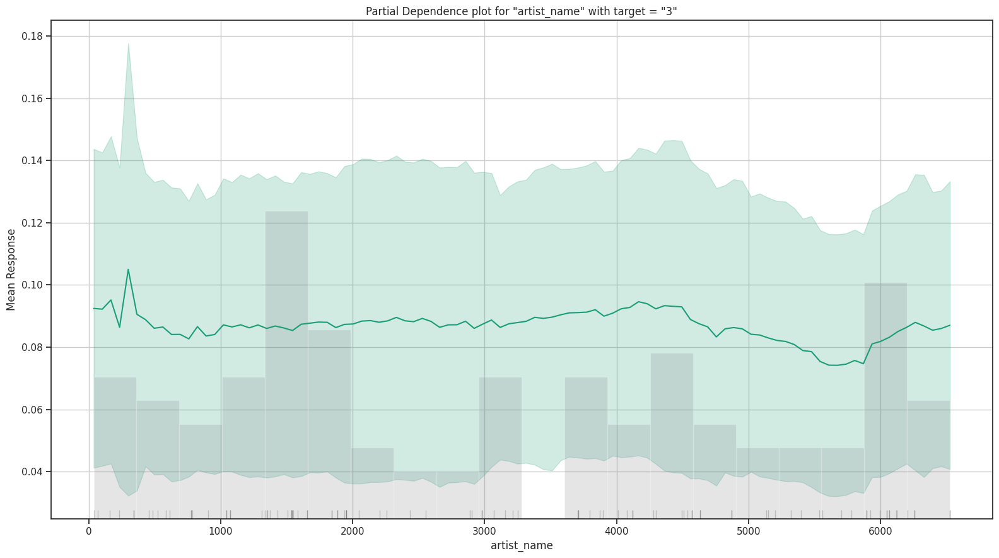

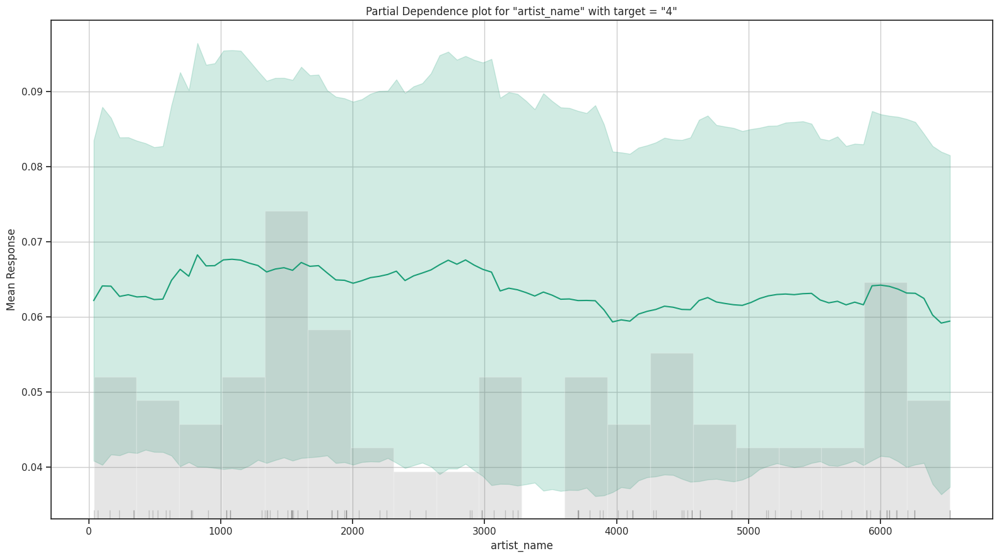

...

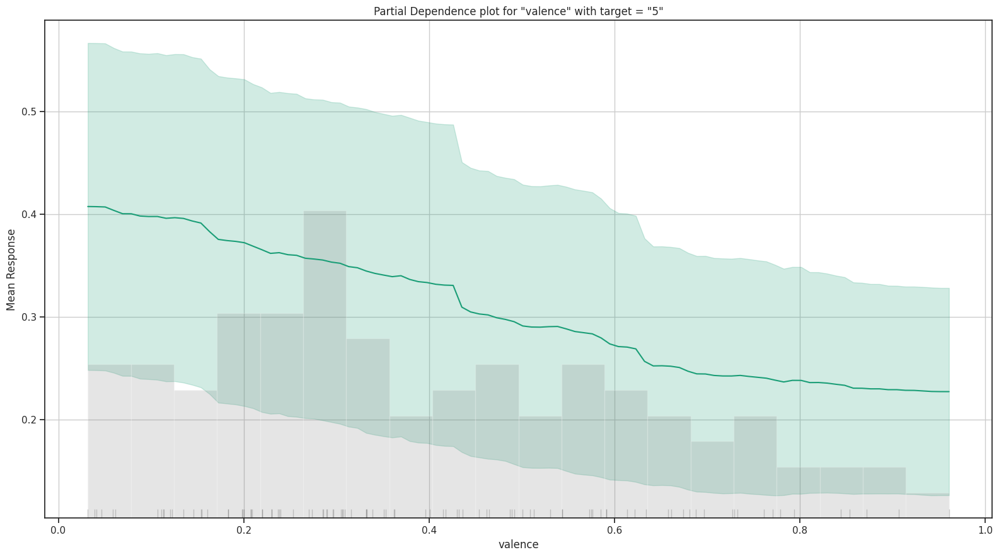

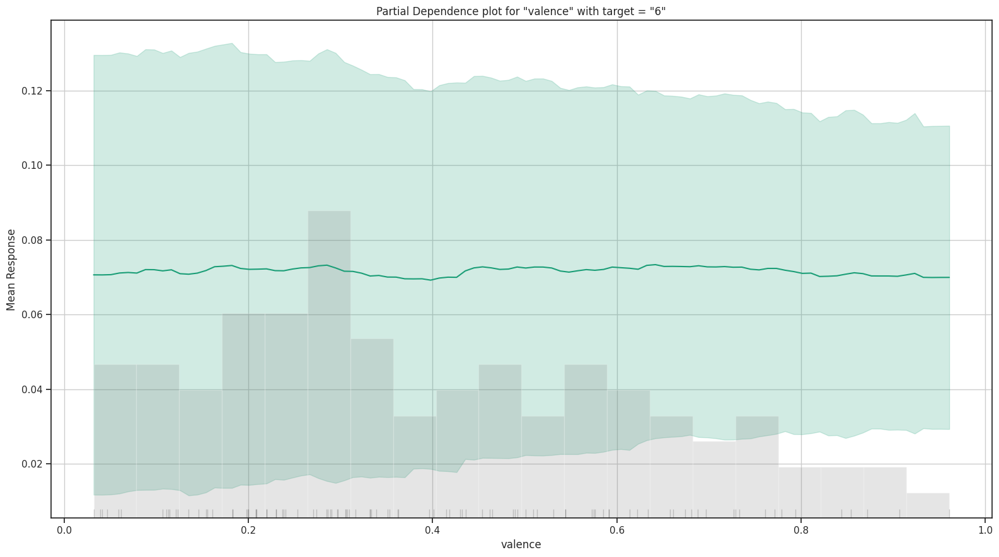

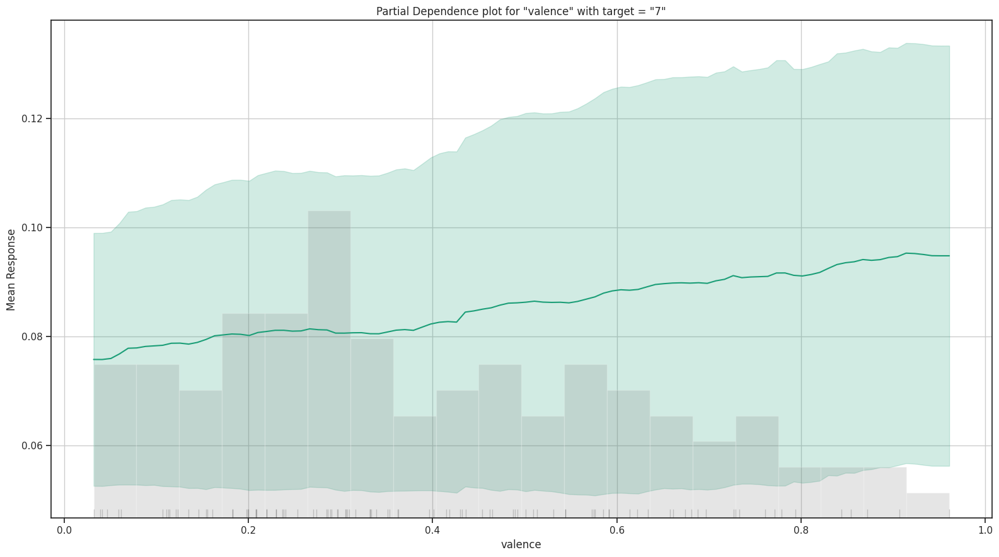

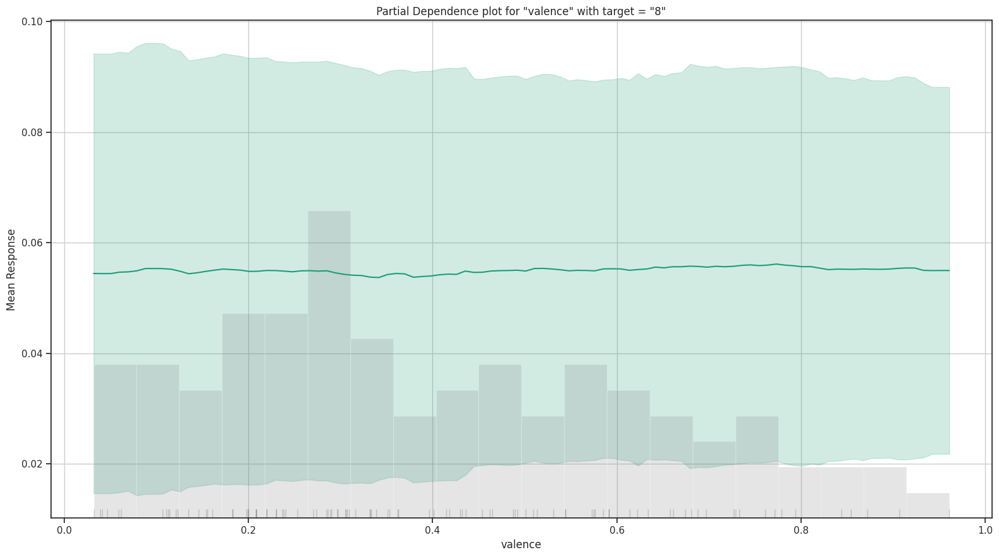

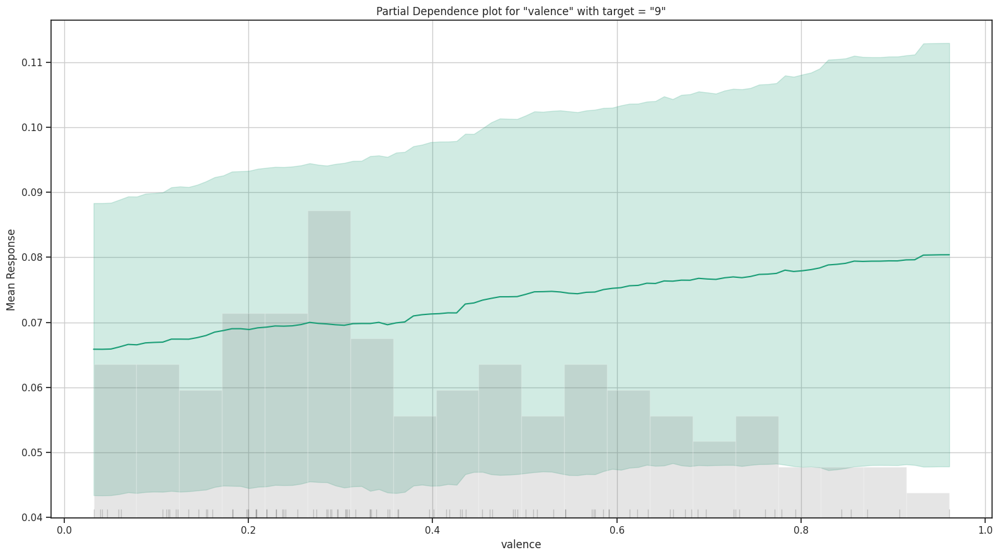

In [76]:
best_model.explain(df_train[0:100,:])

Partial Dependence Plots (PDP):
Partial dependence plots illustrate the relationship between a target variable and a set of predictor variables, while holding other predictors constant. They provide insights into how the predicted outcome changes as a function of one or more input variables, allowing us to understand the marginal effect of each predictor on the target variable. PDPs are useful for interpreting the impact of individual features on model predictions and identifying nonlinear relationships.

Learning Curve Plots:
Learning curve plots depict the performance of a machine learning model as a function of training data size. They  show how the model's accuracy or error rate changes as the amount of training data increases. Learning curves help assess whether a model is suffering from high bias (underfitting) or high variance (overfitting). By analyzing learning curves, we can determine if collecting more data is likely to improve the model's performance or if the model would benefit more from algorithmic adjustments or feature engineering.

**SHAP Analysis for automl best model**

In [77]:
# calling the predict function, and then converting the predictions back to a pandas DataFrame.
def automl_predict_proba(data_as_numpy):
    # Convert numpy array to pandas DataFrame
    data_as_df = pd.DataFrame(data_as_numpy, columns=X_train.columns)
    # If using H2O, convert pandas DataFrame to H2OFrame
    data_as_h2o = h2o.H2OFrame(data_as_df)
    # Use the AutoML model to make predictions
    preds = best_model.predict(data_as_h2o)
    # Extract the prediction probabilities (for classification)
    # The exact way to do this will depend on your model's output format
    prediction_probabilities = preds.as_data_frame().values
    return prediction_probabilities

In [78]:
# Now, initialize the KernelExplainer with the prediction function
# Use a representative subset of your training data for the background distribution
background = shap.sample(X_train, 100)  # Adjust the sample size as necessary

kernel_explainer = shap.KernelExplainer(automl_predict_proba, background)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


In [79]:
# Calculate SHAP values using the KernelExplainer for a subset of your test data
# Again, due to computational expense, you may want to use a subset of your test data
shap_values = kernel_explainer.shap_values(shap.sample(X_test, 30))

  0%|          | 0/30 [00:00<?, ?it/s]

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
stackedensemble prediction progress: |███████████████████████████████████████████| (done) 100%


/usr/local/lib/python3.10/dist-packages/h2o/frame.py:1983: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install datatable (for Python 3.9 or lower), or polars and pyarrow (for Python 3.10 or above) and activate it using:

with h2o.utils.threading.local_context(polars_enabled=True, datatable_enabled=True):
    pandas_df = h2o_df.as_data_frame()

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


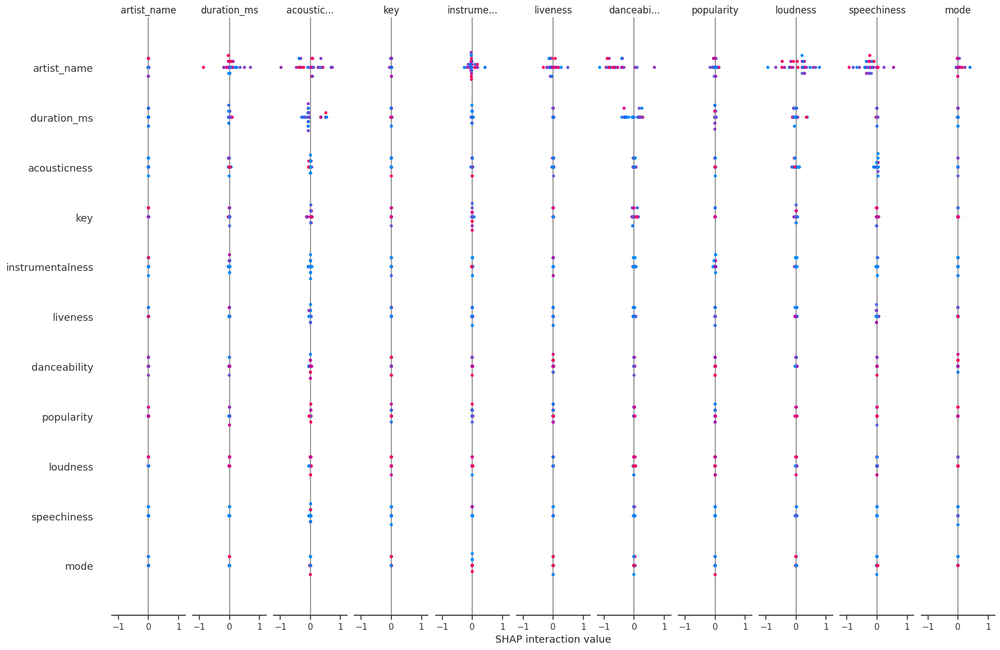

In [80]:
# Plotting the SHAP summary plot
shap.summary_plot(shap_values, shap.sample(X_test, 30),max_display=X_test.shape[1])

**SHAP Analysis Interpretation**

FRom the above shap plot, popularity is the most important feature followed by instrumentalness. Mode and Key appear to be the least important features in classification.
Below are the impact of each feature with respect to prediction:

Popularity: There is a mix of positive and negative impacts on the predictions, with a cluster of high positive impact points. This indicates that for some songs, higher popularity significantly increases the model's output, while for others it decreases or has little effect.

Instrumentalness: This feature shows a strong set of positive SHAP values, meaning that higher instrumentalness tends to increase the model's output value.

Danceability: Similarly, danceability has a mixture of positive SHAP values, indicating that it typically has a positive impact on the model's output.

Liveness: Liveness has both positive and negative impacts, suggesting that its effect varies widely depending on the song.

Mode: The mode feature doesn't have a strong impact in either direction, implying that it may not be a decisive factor in the model's predictions.

Duration_ms: The duration in milliseconds of the song seems to have a balanced mix of positive and negative impacts, indicating that song length can either increase or decrease the model's output, depending on the song.

Key: Musical key appears to have a minimal impact on the model's output, with most points clustered around the zero line.

Acousticness: Acousticness shows a pattern of positive impacts, suggesting that more acoustic tracks may increase the model's output.

Loudness: Loudness mostly impacts the model's predictions positively, indicating that louder songs tend to increase the model output.

Speechiness: This feature has a spread of effects, with a slightly heavier concentration of positive impacts.

Tempo: Lastly, the tempo seems to have a broad range of impacts from negative to positive, showing that the tempo can affect the model's predictions in either direction depending on the context of the song.

**INFERENCE FOR MODEL INTERPRETABILITY BASED ON SHAP VALUES AND FEATURE IMPORTANCE**

SHAP ANALYSIS

Important Features Comparison: In all three plots, we compare the impact of features by looking at the color intensity and spread of the SHAP values. Features with wider spreads and more intense colors have a larger impact on model predictions.

Model Interpretability Comparison Using SHAP:
Logistic Regression (LR): Typically offers high interpretability since it is a linear model with each feature having a constant effect.

XGBoost: offers moderate interpretability compared to simpler models like logistic regression. While logistic regression models have a linear decision boundary, XGBoost uses ensemble learning with decision trees, allowing for more complex and non-linear decision boundaries.

AutoML: This could be less interpretable, depending on the complexity of the underlying models used. Ensemble models, which may include random forests, gradient boosting machines, or neural networks, can have many interactions and non-linear relationships that are a bit harder to summarize with SHAP values.

From interpretation of SHAP analysis using all the 3 models, almost similiar results are obtained since popularity stands as the most important feature for prediction in all 3 cases and key and mode tend to have the least impact on the output genre

FEATURE IMPORTANCE

Comparison of Important Features:

Popularity: Consistently identified as crucial across all methods, indicating its strong influence on genre classification.

Danceability: Identified as important by repeated feature elimination and permutation importance, suggesting its relevance in predicting music genre.

Loudness: Highlighted as important by all methods, underlining its significant impact on genre classification.

Acousticness: Identified by both repeated feature elimination and permutation importance, indicating its relevance in genre prediction.

Instrumentalness and Speechiness: These features are emphasized by different methods, suggesting their varying degrees of importance across models.

In summary, instrumentalness, popularity, loudness, danceability, and acousticness emerge as the most important features in predicting music genre across different methods. While there is some variation in the exact ranking of importance between methods, these features consistently stand out as influential predictors in genre classification.




**FINAL INFERENCES REPORT**

1. What is the question?

  The central goal of this project was to understand which factors most significantly influence the prediction of music genres. Utilizing a dataset comprised of various audio features extracted from Spotify tracks, the investigation sought to find out the critical predictors, evaluate data quality, and maximize prediction accuracy through different modeling approaches. This encompassed scrutinizing the type and distribution of data, identifying missing values, selecting relevant features, and implementing models with and without outliers to determine their impact on predictive performance.

2. What did you do?

 Multi-stage analysis that commenced with meticulous data cleaning and feature selection was carried out, using multiple methods to find essential predictors and address missing values. We evaluated the distribution and independence of features, examining the data's integrity across training and testing sets. A linear model and a tree-based model were developed, alongside leveraging AutoML for optimal model selection. Post-model development, we conducted SHAP analysis to decipher model decision-making processes and feature impacts. The process was iterative, comparing model outcomes with and without outliers and refining hyperparameters to enhance performance.

3. How well did it work?

  The modeling efforts yielded nuanced results. Initially, models performed marginally better with outliers present; however, with refined hyperparameter tuning, this discrepancy diminished, and models based on cleaned datasets demonstrated comparable accuracy. The linear model provided baseline insights, while the tree-based model and AutoML approaches uncovered complex patterns, revealing a more intricate feature interplay. The efficacy of imputation methods on removed data segments illuminated the resilience and limitations of our models, with SHAP analysis granting us a granular understanding of feature influences, enhancing our confidence in the models' predictive abilities.

4. What did you learn?

  From this analytical journey, several insights emerged. Notably, the relative importance of features such as artist_name and acousticness was consistent across models, emphasizing the role of artist style and track properties in genre classification.The changes in imputation methods and hyper paramater tuning and preprocessing turned out to be crucial for my results. The data cleaning and outlier management strategies were handled by the marginal difference in accuracy post-tuning, validating the approach. The robustness of imputation techniques was shown in maintaining model integrity. Finally, the interpretability analysis, particularly through SHAP, was invaluable in identifying the models' internal logic, confirming the soundness of  feature selection and the transparency of  predictive models.

**Conclusion**

The notebook extensively explores music genre prediction using H2O.ai AutoML with Spotify's music track dataset. Through meticulous data preprocessing, feature selection, outlier handling, and model optimization, it addresses key aspects such as relationship significance, multicollinearity, and model coherence. The linear model offers interpretable coefficients, aiding in understanding the linear relationships between predictors and the target variable. Tree-based models provide interpretability through decision tree structures, facilitating intuitive comprehension of decision rules. AutoML streamlines model selection without manual intervention, saving time and effort. SHAP analysis offers a unified approach to interpretability, revealing insights into feature importance and their impact across different models. Comparing SHAP analysis results across models enhances understanding of feature importance and their contributions to predictions in varied modeling approaches.

**License**

MIT License

Copyright (c) 2024 Malini Janaki Sankaran

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.

**References**

1) https://towardsdatascience.com/6-predictive-models-models-every-beginner-data-scientist-should-master-7a37ec8da76d

2) https://www.software.com/src/explore-the-data-behind-your-most-productive-music-for-coding

3) https://docs.h2o.ai/h2o/latest-stable/h2o-docs/welcome.html

4) https://towardsdatascience.com/a-deep-dive-into-h2os-automl-4b1fe51d3f3e

5) https://www.analyticsvidhya.com/blog/2021/02/unboxing-h2o-automl-models/

6) https://towardsdatascience.com/automated-machine-learning-with-h2o-258a2f3a203f

7) https://towardsdatascience.com/automated-machine-learning-with-h2o-258a2f3a203f

8) https://www.youtube.com/watch?v=MQ6fFDwjuco

9) https://www.analyticsvidhya.com/blog/2020/03/one-hot-encoding-vs-label-encoding-using-scikit-learn/

10) https://www.analyticsvidhya.com/blog/2021/02/unboxing-h2o-automl-models/